# 项目名： A股增强Alpha
## 介绍
利用zipline回测工具，实现A股数据的策略开发全过程。
所谓增强Alpha，顾名思义是基于验证过单因子有效性的多个alpha因子为基础，为了最大化超额收益，利用各种方式对alpha因子进行组合的策略。
此项目采用了随机森林和XGboost这两种集成学习（Ensemble Learning）算法。
参考[集成学习](https://www.cnblogs.com/zongfa/p/9304353.html).


### 显示Bundles状态

In [1]:
!zipline bundles

csvdir <no ingestions>
quandl <no ingestions>
quantopian-quandl 2020-10-28 15:36:38.072482


### 载入必要库

In [2]:
import sys
import project_helper
import project_tests

import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt

%matplotlib inline
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (14, 8)

C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\statsmodels\compat\pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


## 构建数据Pipeline
在线平台性能上很难满足大规模调试策略，加上机器学习或深度学习等计算密集型模型，所以本地回测如何提高效率是第一待解决的问题。
而zipline中的pipeline机制是很高效的。
### Bundle的注册
因为此项目我们用Zipline来处理数据，1.2章节中我们创建了数据Bundle。
此处我们需要注册创建的Bundle方便Zipline调用数据。

In [3]:
import sys
import os
from zipline.data import bundles

os.environ['ZIPLINE_ROOT'] = os.path.join('C:/Users/ltjsu/.zipline')

ingest_func = bundles.csvdir.csvdir_equities(['daily'], 'custom-csvdir-bundle')
bundles.register('custom-csvdir-bundle', ingest_func)

print('Data Registered')

Data Registered


### 创建Pipeline引擎
我们将运用Pipeline包来处理股票数据。此前，我们需要创建Pipeline引擎，方便之后使用。

In [4]:
from zipline.pipeline import Pipeline
from zipline.pipeline.factors import AverageDollarVolume
from zipline.utils.calendars import get_calendar


universe = AverageDollarVolume(window_length=120).top(500) 
trading_calendar = get_calendar('XSHG')
bundle_data = bundles.load('custom-csvdir-bundle')
engine = project_helper.build_pipeline_engine(bundle_data, trading_calendar)

#### 查看数据
创建Pipeline引擎后，查看股票池最后一天的股票列表。

In [5]:
universe_end_date = pd.Timestamp('2020-10-27', tz='UTC')

universe_tickers = engine\
    .run_pipeline(
        Pipeline(screen=universe),
        universe_end_date,
        universe_end_date)\
    .index.get_level_values(1)\
    .values.tolist()
    
universe_tickers[:10]

[Equity(0 [000001]),
 Equity(1 [000002]),
 Equity(2 [000009]),
 Equity(3 [000011]),
 Equity(4 [000016]),
 Equity(5 [000021]),
 Equity(6 [000034]),
 Equity(7 [000063]),
 Equity(8 [000066]),
 Equity(9 [000069])]

简单处理股票列表信息，方便获取申万行业数据。

In [6]:
Select_Stock = []

for i in range(len(universe_tickers)):
    Select_Stock.append(str(universe_tickers[i])[-8:-2])

Select_Stock[:10]

['000001',
 '000002',
 '000009',
 '000011',
 '000016',
 '000021',
 '000034',
 '000063',
 '000066',
 '000069']

### 获取收益率
构建DataPortal获取个股收益率数据。

In [7]:
from zipline.data.data_portal import DataPortal

data_portal = DataPortal(
    bundle_data.asset_finder,
    trading_calendar=trading_calendar,
    first_trading_day=bundle_data.equity_daily_bar_reader.first_trading_day,
    equity_minute_reader=None,
    equity_daily_reader=bundle_data.equity_daily_bar_reader,
    adjustment_reader=bundle_data.adjustment_reader)

自定义函数`get_pricing`获取股票收益率，增加代码可读性。

In [8]:
def get_pricing(data_portal, trading_calendar, assets, start_date, end_date, field='close'):
    end_dt = pd.Timestamp(end_date.strftime('%Y-%m-%d'), tz='UTC', offset='C')
    start_dt = pd.Timestamp(start_date.strftime('%Y-%m-%d'), tz='UTC', offset='C')

    end_loc = trading_calendar.closes.index.get_loc(end_dt)
    start_loc = trading_calendar.closes.index.get_loc(start_dt)

    return data_portal.get_history_window(
        assets=assets,
        end_dt=end_dt,
        bar_count=end_loc - start_loc,
        frequency='1d',
        field=field,
        data_frequency='daily')

# Alpha因子
定义Alpha因子。此项目主要关注以下因子：
- 动量因子_1年
- 行业中性均值回归_5日平滑因子
- 隔夜情绪平滑因子

**此处务必保证，factor_start_date不是周末和节假日，不然后面会报错**

In [9]:
from zipline.pipeline.factors import CustomFactor, DailyReturns, Returns, SimpleMovingAverage, AnnualizedVolatility
from zipline.pipeline.data import USEquityPricing

##定义数据集截止日期
universe_end_date = pd.Timestamp('2020-10-27', tz='UTC')
##定义数据集时间跨度
factor_start_date = universe_end_date - pd.DateOffset(years=5, days=4)
print(factor_start_date)
sector = project_helper.Sector()

def momentum_1yr(window_length, universe, sector):
    return Returns(window_length=window_length, mask=universe) \
        .demean(groupby=sector) \
        .rank() \
        .zscore()

def mean_reversion_5day_sector_neutral_smoothed(window_length, universe, sector):
    unsmoothed_factor = -Returns(window_length=window_length, mask=universe) \
        .demean(groupby=sector) \
        .rank() \
        .zscore()
    return SimpleMovingAverage(inputs=[unsmoothed_factor], window_length=window_length) \
        .rank() \
        .zscore()

class CTO(Returns):
    """
    Computes the overnight return, per hypothesis from
    https://papers.ssrn.com/sol3/papers.cfm?abstract_id=2554010
    """
    inputs = [USEquityPricing.open, USEquityPricing.close]
    
    def compute(self, today, assets, out, opens, closes):
        """
        The opens and closes matrix is 2 rows x N assets, with the most recent at the bottom.
        As such, opens[-1] is the most recent open, and closes[0] is the earlier close
        """
        out[:] = (opens[-1] - closes[0]) / closes[0]
        
class TrailingOvernightReturns(Returns):
    """
    Sum of trailing 1m O/N returns
    """
    window_safe = True
    
    def compute(self, today, asset_ids, out, cto):
        out[:] = np.nansum(cto, axis=0)

def overnight_sentiment_smoothed(cto_window_length, trail_overnight_returns_window_length, universe):
    cto_out = CTO(mask=universe, window_length=cto_window_length)
    unsmoothed_factor = TrailingOvernightReturns(inputs=[cto_out], window_length=trail_overnight_returns_window_length) \
        .rank() \
        .zscore()
    return SimpleMovingAverage(inputs=[unsmoothed_factor], window_length=trail_overnight_returns_window_length) \
        .rank() \
        .zscore()

2015-10-23 00:00:00+00:00


### 往Pipeline中添加因子
将以上因子添加到Pipeline中。

In [10]:
universe = AverageDollarVolume(window_length=120).top(500)
sector = project_helper.Sector()

pipeline = Pipeline(screen=universe)
pipeline.add(
    momentum_1yr(252, universe, sector),
    'Momentum_1YR')
pipeline.add(
    mean_reversion_5day_sector_neutral_smoothed(20, universe, sector),
    'Mean_Reversion_Sector_Neutral_Smoothed')
pipeline.add(
    overnight_sentiment_smoothed(2, 10, universe),
    'Overnight_Sentiment_Smoothed')

## 特征工程
定义一些对模型预测有帮助的特征。 好的基础特征能够作为显著的条件因子，对模型最终的预测有帮助。
### 一些”通用“量化特征
为了体现通用性，我们运用一下基础特征：
- 股票波动 20日平滑, 120日平滑
- 成交量量 20日平滑, 120日平滑
- 行业

In [11]:
pipeline.add(AnnualizedVolatility(window_length=20, mask=universe).rank().zscore(), 'volatility_20d')
pipeline.add(AnnualizedVolatility(window_length=120, mask=universe).rank().zscore(), 'volatility_120d')
pipeline.add(AverageDollarVolume(window_length=20, mask=universe).rank().zscore(), 'adv_20d')
pipeline.add(AverageDollarVolume(window_length=120, mask=universe).rank().zscore(), 'adv_120d')
pipeline.add(sector, 'sector_code')

### 市场特征
Regime Features
为了抓取市场特性，我们运用一下特征：
- 市场波动 20日平滑, 120日平滑
- 市场分散（离差） 20日平滑, 120日平滑

In [12]:
class MarketDispersion(CustomFactor):
    inputs = [DailyReturns()]
    window_length = 1
    window_safe = True

    def compute(self, today, assets, out, returns):
        # returns are days in rows, assets across columns
        out[:] = np.sqrt(np.nanmean((returns - np.nanmean(returns))**2))


pipeline.add(SimpleMovingAverage(inputs=[MarketDispersion(mask=universe)], window_length=20), 'dispersion_20d')
pipeline.add(SimpleMovingAverage(inputs=[MarketDispersion(mask=universe)], window_length=120), 'dispersion_120d')

In [13]:
class MarketVolatility(CustomFactor):
    inputs = [DailyReturns()]
    window_length = 1
    window_safe = True
    
    def compute(self, today, assets, out, returns):
        mkt_returns = np.nanmean(returns, axis=1)
        out[:] = np.sqrt(260.* np.nanmean((mkt_returns-np.nanmean(mkt_returns))**2))


pipeline.add(MarketVolatility(window_length=20), 'market_vol_20d')
pipeline.add(MarketVolatility(window_length=120), 'market_vol_120d')

### 标签--预测目标
此项目对未来一周的收益做预测。因此量化目标过程中，因子追踪五日收益率。

In [14]:
pipeline.add(Returns(window_length=5, mask=universe).quantiles(2), 'return_5d')
pipeline.add(Returns(window_length=5, mask=universe).quantiles(25), 'return_5d_p')
pipeline.add(DailyReturns(mask=universe).quantiles(2), 'return_1d')
pipeline.add(DailyReturns(mask=universe).quantiles(10), 'return_1d_p')

### 日期特征
因为日历异象（calendar anomalies）的存在，此处定义一些日期相关的特征。

**此处务必保证，factor_start_date不是周末和节假日，不然会报错**

In [15]:
all_factors = engine.run_pipeline(pipeline, factor_start_date, universe_end_date)

all_factors['is_Janaury'] = all_factors.index.get_level_values(0).month == 1
all_factors['is_December'] = all_factors.index.get_level_values(0).month == 12
all_factors['weekday'] = all_factors.index.get_level_values(0).weekday
all_factors['quarter'] = all_factors.index.get_level_values(0).quarter
all_factors['qtr_yr'] = all_factors.quarter.astype('str') + '_' + all_factors.index.get_level_values(0).year.astype('str')
all_factors['month_end'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BM'))
all_factors['month_start'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BMS'))
all_factors['qtr_end'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BQ'))
all_factors['qtr_start'] = all_factors.index.get_level_values(0).isin(pd.date_range(start=factor_start_date, end=universe_end_date, freq='BQS'))

all_factors.head(5)

Mean_Reversion_Sector_Neutral_Smoothed  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])                              0.59437882   
                          Equity(1 [000002])                              1.23519349   
                          Equity(2 [000009])                             -0.00928717   
                          Equity(3 [000011])                             -1.04016294   
                          Equity(4 [000016])                              1.71812628   

                                              Momentum_1YR  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])   -1.01036778   
                          Equity(1 [000002])   -0.82860850   
                          Equity(2 [000009])    0.10157136   
                          Equity(3 [000011])   -0.76445816   
                          Equity(4 [000016])    0.92483400   

                                              Overnight_Sentiment_Smoothed  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])                    0.54075914   
                          Equity(1 [000002])                    0.36186138   
                          Equity(2 [000009])                    1.68733114   
                          Equity(3 [000011])                   -0.80910578   
                          Equity(4 [000016])                   -0.73592033   

                                                adv_120d     adv_20d  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])  1.45151137  0.87415951   
                          Equity(1 [000002])  1.59788226  1.15063786   
                          Equity(2 [000009])  0.86602779  1.54096025   
                          Equity(3 [000011]) -0.71152518 -0.54889085   
                          Equity(4 [000016]) -0.28054421  1.59788226   

                                              dispersion_120d  dispersion_20d  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])       0.04173601      0.03804019   
                          Equity(1 [000002])       0.04173601      0.03804019   
                          Equity(2 [000009])       0.04173601      0.03804019   
                          Equity(3 [000011])       0.04173601      0.03804019   
                          Equity(4 [000016])       0.04173601      0.03804019   

                                              market_vol_120d  market_vol_20d  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])       0.69036789      0.47614087   
                          Equity(1 [000002])       0.69036789      0.47614087   
                          Equity(2 [000009])       0.69036789      0.47614087   
                          Equity(3 [000011])       0.69036789      0.47614087   
                          Equity(4 [000016])       0.69036789      0.47614087   

                                              return_1d    ...      \
2015-10-23 00:00:00+00:00 Equity(0 [000001])          0    ...       
                          Equity(1 [000002])          0    ...       
                          Equity(2 [000009])          1    ...       
                          Equity(3 [000011])          1    ...       
                          Equity(4 [000016])          0    ...       

                                              volatility_20d  is_Janaury  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])     -1.66474872       False   
                          Equity(1 [000002])     -1.67372311       False   
                          Equity(2 [000009])      0.16602615       False   
                          Equity(3 [000011])      0.80320760       False   
                          Equity(4 [000016])      1.66474872       False   

                                              is_December  weekday  quarter  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])        False        4        4   
                          Equity(1 [000002])        False        4        4   
                          Equity(2 [000009])        False        4        4   
                          Equity(3 [000011])        False        4        

In [16]:
all_factors['return_5d'].replace(to_replace=-1, value=np.nan, inplace=True)
all_factors['return_1d'].replace(to_replace=-1, value=np.nan, inplace=True)

### 行业信息独热编码
独热编码有助于模型更好的理解行业信息。

In [17]:
sector_lookup = pd.read_csv(
    os.path.join(os.getcwd(), 'data', 'project_7_sector', 'labels.csv'),
    index_col='Sector_i')['Sector'].to_dict()
sector_lookup

sector_columns = []
for sector_i, sector_name in sector_lookup.items():
    secotr_column = '{}行业'.format(sector_name)
    sector_columns.append(secotr_column)
    all_factors[secotr_column] = (all_factors['sector_code'] == sector_i)

all_factors[sector_columns].head()

采掘行业   化工行业   钢铁行业  有色金属行业  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])  False  False  False   False   
                          Equity(1 [000002])  False  False  False   False   
                          Equity(2 [000009])  False  False  False   False   
                          Equity(3 [000011])  False  False  False   False   
                          Equity(4 [000016])  False  False  False   False   

                                              建筑材料行业  建筑装饰行业  电气设备行业  机械设备行业  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])   False   False   False   False   
                          Equity(1 [000002])   False   False   False   False   
                          Equity(2 [000009])   False   False   False   False   
                          Equity(3 [000011])   False   False   False   False   
                          Equity(4 [000016])   False   False   False   False   

                                              国防军工行业   汽车行业  ...    公用事业行业  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])   False  False  ...     False   
                          Equity(1 [000002])   False  False  ...     False   
                          Equity(2 [000009])   False  False  ...     False   
                          Equity(3 [000011])   False  False  ...     False   
                          Equity(4 [000016])   False  False  ...     False   

                                              交通运输行业  房地产行业   电子行业  计算机行业  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])   False  False  False  False   
                          Equity(1 [000002])   False   True  False  False   
                          Equity(2 [000009])   False  False  False  False   
                          Equity(3 [000011])   False   True  False  False   
                          Equity(4 [000016])   False  False  False  False   

                                               传媒行业   通信行业   银行行业  非银金融行业  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])  False  False   True   False   
                          Equity(1 [000002])  False  False  False   False   
                          Equity(2 [000009])  False  False  False   False   
                          Equity(3 [000011])  False  False  False   False   
                          Equity(4 [000016])  False  False  False   False   

                                               综合行业  
2015-10-23 00:00:00+00:00 Equity(0 [000001])  False  
                          Equity(1 [000002])  False  
                          Equity(2 [000009])   True  
                          Equity(3 [000011])  False  
                          Equity(4 [000016])  False  

[5 rows x 28 columns]

### 日期平移
每日收益率往前平移5日（一周），作为模型目标。

In [18]:
# all_factors['target'] = all_factors.groupby(level=1)['return_5d'].shift(-5)
all_factors['target'] = all_factors.groupby(level=1)['return_1d'].shift(-1)

# all_factors[['return_5d','target']].reset_index().sort_values(['level_1', 'level_0']).head(10)
all_factors[['return_1d','target']].reset_index().sort_values(['level_1', 'level_0']).head(10)

,level_0,level_1,return_1d,target
0,2015-10-23 00:00:00+00:00,Equity(0 [000001]),0.00000000,0.00000000
426,2015-10-26 00:00:00+00:00,Equity(0 [000001]),0.00000000,0.00000000
852,2015-10-27 00:00:00+00:00,Equity(0 [000001]),0.00000000,0.00000000
1278,2015-10-28 00:00:00+00:00,Equity(0 [000001]),0.00000000,1.00000000
1704,2015-10-29 00:00:00+00:00,Equity(0 [000001]),1.00000000,0.00000000
2130,2015-10-30 00:00:00+00:00,Equity(0 [000001]),0.00000000,1.00000000
2556,2015-11-02 00:00:00+00:00,Equity(0 [000001]),1.00000000,1.00000000
2982,2015-11-03 00:00:00+00:00,Equity(0 [000001]),1.00000000,0.00000000
3409,2015-11-04 00:00:00+00:00,Equity(0 [000001]),0.00000000,1.00000000
3836,2015-11-05 00:00:00+00:00,Equity(0 [000001]),1.00000000,1.00000000


### 目标独立相似分布（IID）检测
查看平移不同时长的收益率之间是否是独立同分布。
**斯皮尔曼相关度计算**

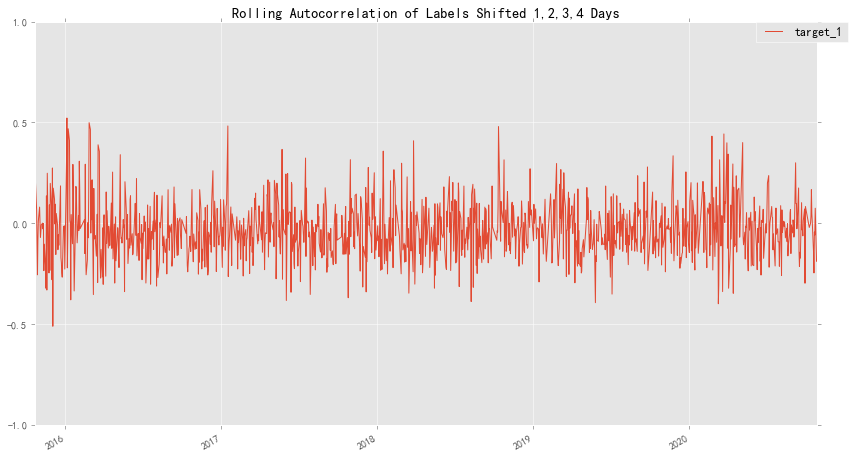

In [19]:
from scipy.stats import spearmanr

def sp(group, col1_name, col2_name):
    x = group[col1_name]
    y = group[col2_name]
    return spearmanr(x, y)[0]


# all_factors['target_p'] = all_factors.groupby(level=1)['return_5d_p'].shift(-5)
# all_factors['target_1'] = all_factors.groupby(level=1)['return_5d'].shift(-4)
# all_factors['target_2'] = all_factors.groupby(level=1)['return_5d'].shift(-3)
# all_factors['target_3'] = all_factors.groupby(level=1)['return_5d'].shift(-2)
# all_factors['target_4'] = all_factors.groupby(level=1)['return_5d'].shift(-1)
all_factors['target_p'] = all_factors.groupby(level=1)['return_1d_p'].shift(-1)
all_factors['target_1'] = all_factors.groupby(level=1)['return_1d'].shift(0)

g = all_factors.dropna().groupby(level=0)
# for i in range(4):
for i in range(1):
    label = 'target_'+str(i+1)
    ic = g.apply(sp, 'target', label)
    ic.plot(ylim=(-1, 1), label=label)
plt.legend(bbox_to_anchor=(1.04, 1), borderaxespad=0)
plt.title('Rolling Autocorrelation of Labels Shifted 1,2,3,4 Days')
plt.show()

### 标签平移对于自相关的影响
从上图中可以观察到：

$ 自相关{Target1} > 自相关{Target2} > 自相关{Target3} > 自相关{Target4}$

自相关随着增加两次收益之间的间隔而减小。 自相关在正范围内，这意味着未来收益趋向于与过去收益相同的方向。此外，滞后1的自相关约在0.5附件振荡，滞后4的自相关约在0附近振荡，因此序列相关的程度从中等到非常低

这与股票收益通常表现出序列相关性是一致的

### 拆分训练集/验证集/测试集
将数据分为训练，验证和测试数据集。 实现函数“ train_valid_test_split”将输入样本“ all_x”和目标值“ all_y”分割为训练，验证和测试数据集。 比例大小分别是“ train_size”，“ valid_size”和“ test_size”。

分割时，请确保数据分别来自训练，验证和测试的顺序。 假设“ train_size”为0.7，“ valid_size”为0.2，而“ test_size”为0.1。 all_x和all_y的前70％是训练集合。 接下来的all_x和all_y 20％将是验证集。 all_x和all_y的最后10％是测试集。 确保不要将同一天分配给多个数据集，它应包含在单个数据集中。

In [20]:
def train_valid_test_split(all_x, all_y, train_size, valid_size, test_size):
    """
    Generate the train, validation, and test dataset.

    Parameters
    ----------
    all_x : DataFrame
        All the input samples
    all_y : Pandas Series
        All the target values
    train_size : float
        The proportion of the data used for the training dataset
    valid_size : float
        The proportion of the data used for the validation dataset
    test_size : float
        The proportion of the data used for the test dataset

    Returns
    -------
    x_train : DataFrame
        The train input samples
    x_valid : DataFrame
        The validation input samples
    x_test : DataFrame
        The test input samples
    y_train : Pandas Series
        The train target values
    y_valid : Pandas Series
        The validation target values
    y_test : Pandas Series
        The test target values
    """
    assert train_size >= 0 and train_size <= 1.0
    assert valid_size >= 0 and valid_size <= 1.0
    assert test_size >= 0 and test_size <= 1.0
    assert train_size + valid_size + test_size == 1.0
    
    # TODO: Implement
    train_inx = int(len(all_x) * train_size)
    valid_ind = int(len(all_x) * (train_size + valid_size))
    x_train = all_x[:train_inx]
    x_valid = all_x[train_inx:valid_ind]
    x_test  = all_x[valid_ind:]
    y_train = all_y[:train_inx]
    y_valid = all_y[train_inx:valid_ind]
    y_test  = all_y[valid_ind:]
    
    return x_train, x_valid, x_test, y_train, y_valid, y_test


project_tests.test_train_valid_test_split(train_valid_test_split)

Tests Passed


得到`train_valid_test_split`之后，就可以将数据拆分成训练集、验证集和测试集。
选取如下特征和5日收益率为预测目标。

In [21]:
features = [
    'Mean_Reversion_Sector_Neutral_Smoothed', 'Momentum_1YR',
    'Overnight_Sentiment_Smoothed', 'adv_120d', 'adv_20d',
    'dispersion_120d', 'dispersion_20d', 'market_vol_120d',
    'market_vol_20d', 'volatility_20d',
    'is_Janaury', 'is_December', 'weekday',
    'month_end', 'month_start', 'qtr_end', 'qtr_start'] + sector_columns
target_label = 'target'

temp = all_factors.dropna().copy()
X = temp[features]
y = temp[target_label].astype(int)

X_train, X_valid, X_test, y_train, y_valid, y_test = train_valid_test_split(X, y, 0.8, 0.1, 0.1)

X_train.head()

Mean_Reversion_Sector_Neutral_Smoothed  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])                              0.59437882   
                          Equity(1 [000002])                              1.23519349   
                          Equity(2 [000009])                             -0.00928717   
                          Equity(3 [000011])                             -1.04016294   
                          Equity(4 [000016])                              1.71812628   

                                              Momentum_1YR  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])   -1.01036778   
                          Equity(1 [000002])   -0.82860850   
                          Equity(2 [000009])    0.10157136   
                          Equity(3 [000011])   -0.76445816   
                          Equity(4 [000016])    0.92483400   

                                              Overnight_Sentiment_Smoothed  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])                    0.54075914   
                          Equity(1 [000002])                    0.36186138   
                          Equity(2 [000009])                    1.68733114   
                          Equity(3 [000011])                   -0.80910578   
                          Equity(4 [000016])                   -0.73592033   

                                                adv_120d     adv_20d  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])  1.45151137  0.87415951   
                          Equity(1 [000002])  1.59788226  1.15063786   
                          Equity(2 [000009])  0.86602779  1.54096025   
                          Equity(3 [000011]) -0.71152518 -0.54889085   
                          Equity(4 [000016]) -0.28054421  1.59788226   

                                              dispersion_120d  dispersion_20d  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])       0.04173601      0.03804019   
                          Equity(1 [000002])       0.04173601      0.03804019   
                          Equity(2 [000009])       0.04173601      0.03804019   
                          Equity(3 [000011])       0.04173601      0.03804019   
                          Equity(4 [000016])       0.04173601      0.03804019   

                                              market_vol_120d  market_vol_20d  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])       0.69036789      0.47614087   
                          Equity(1 [000002])       0.69036789      0.47614087   
                          Equity(2 [000009])       0.69036789      0.47614087   
                          Equity(3 [000011])       0.69036789      0.47614087   
                          Equity(4 [000016])       0.69036789      0.47614087   

                                              volatility_20d  ...    公用事业行业  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])     -1.66474872  ...     False   
                          Equity(1 [000002])     -1.67372311  ...     False   
                          Equity(2 [000009])      0.16602615  ...     False   
                          Equity(3 [000011])      0.80320760  ...     False   
                          Equity(4 [000016])      1.66474872  ...     False   

                                              交通运输行业  房地产行业   电子行业  计算机行业  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])   False  False  False  False   
                          Equity(1 [000002])   False   True  False  False   
                          Equity(2 [000009])   False  False  False  False   
                          Equity(3 [000011])   False   True  False  False   
                          Equity(4 [000016])   False  False  False  False   

                                               传媒行业   通信行业   银行行业  非银金融行业  \
2015-10-23 00:00:00+00:00 Equity(0 [000001])  False  False   True   False   
                          Equity(1 [000002])  False  False  False   False   
                          Equity(2 [000009])  False  False  False   False   
                      

In [22]:
y_train.value_counts()

0    196585
1    196361
Name: target, dtype: int64

# 集成学习
## 随即森林
### 决策树
单个决策树决策效果展示。

**对标的日期不做区分，使得此模型对股票种类不敏感，时序信息也丢失较多**

**对单一标定分别进行训练，将学习出属于不同标的的特性。高频数据将解决数据不够的问题**

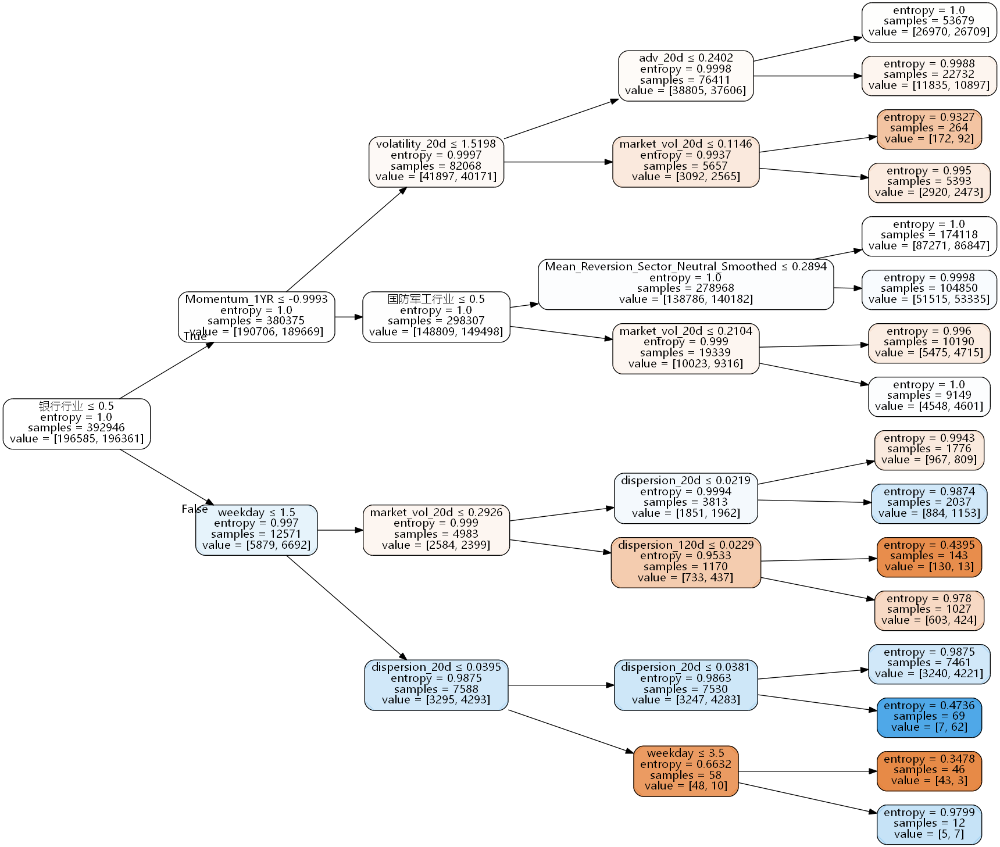

      Feature                                    Importance
 1. dispersion_20d                         (0.2010121312713231)
 2. market_vol_20d                         (0.1914051477958029)
 3. weekday                                (0.16649497298043)
 4. dispersion_120d                        (0.11034810155468212)
 5. 银行行业                                   (0.09142071815442475)
 6. Momentum_1YR                           (0.05795626655498386)
 7. volatility_20d                         (0.052355249667347524)
 8. 国防军工行业                                 (0.05164262774195395)
 9. Mean_Reversion_Sector_Neutral_Smoothed (0.04237603515228031)
10. adv_20d                                (0.03498874912677133)
11. market_vol_120d                        (0.0)
12. 有色金属行业                                 (0.0)
13. is_Janaury                             (0.0)
14. is_December                            (0.0)
15. adv_120d                               (0.0)
16. month_end                              (0.0)


In [23]:
from IPython.display import display
from sklearn.tree import DecisionTreeClassifier


# This is to get consistent results between each run.
clf_random_state = 0
MAX_DEPTH = 4

simple_clf = DecisionTreeClassifier(
    max_depth=MAX_DEPTH,
    criterion='entropy',
    random_state=clf_random_state)
simple_clf.fit(X_train, y_train)

display(project_helper.plot_tree_classifier(simple_clf, feature_names=features))
project_helper.rank_features_by_importance(simple_clf.feature_importances_, features)

### 随机森林超参数 -- 决策树数量
定义不同参数，来确定最好的模型。
#### 参数
参见以下参数

In [24]:
n_days = 10
n_stocks = 500

clf_parameters = {
    'criterion': 'entropy',
    'min_samples_leaf': n_stocks * n_days,
    'oob_score': True,
    'n_jobs': -1,
    'random_state': clf_random_state}
n_trees_l = [10, 20, 50, 100, 250]

##### min_samples_leaf
min_samples_leaf ： 决策树每个叶--也就是决策树最底层样本数量。 足够小，有助于模型抓住数据细节；过于小，模型容易过拟合。
此参数的值以股票池股票数量的倍数为宜。当夏普率大于4的时候，往往是过拟合的征兆，因此建议设置为10倍股票数量。

次倍数可以调节，但过度调试也会在验证集上过拟合，从而降低模型泛化性，样本外数据表现很差。 因此倍数以指数的形式变动（10倍，20倍，100倍，而不是10倍11倍12倍...）。

In [25]:
from sklearn.ensemble import RandomForestClassifier


train_score = []
valid_score = []
oob_score = []
feature_importances = []

for n_trees in tqdm(n_trees_l, desc='Training Models', unit='Model'):
    clf = RandomForestClassifier(n_trees, **clf_parameters)
    clf.fit(X_train, y_train)
    
    train_score.append(clf.score(X_train, y_train.values))
    valid_score.append(clf.score(X_valid, y_valid.values))
    oob_score.append(clf.oob_score_)
    feature_importances.append(clf.feature_importances_)

Training Models:   0%|                                                                        | 0/5 [00:00<?, ?Model/s]C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\sklearn\ensemble\forest.py:439: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\sklearn\ensemble\forest.py:444: RuntimeWarning: invalid value encountered in true_divide
  predictions[k].sum(axis=1)[:, np.newaxis])
Training Models:  20%|████████████▊                                                   | 1/5 [00:04<00:17,  4.50s/Model]C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\sklearn\ensemble\forest.py:439: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
C:\Users\ltjsu\.conda\envs\zipline_en

##### n_trees_l
参考下图，分类器准确率随着决策树数量的变化。

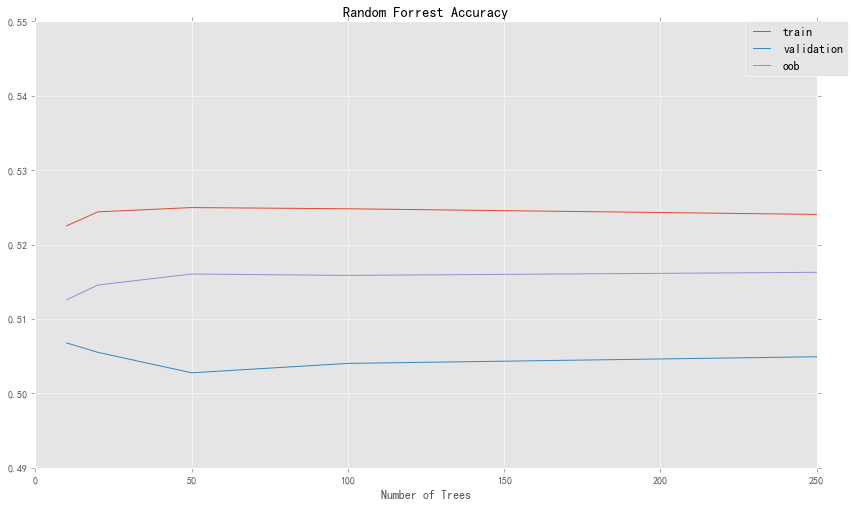

In [26]:
project_helper.plot(
    [n_trees_l]*3,
    [train_score, valid_score, oob_score],
    ['train', 'validation', 'oob'],
    'Random Forrest Accuracy',
    'Number of Trees')

#### 判定过/欠拟合

- 图中验本外数据比验证集准确率高；决策树数量较少时，训练和样本外集准确率随着决策树增加而增加，而验证集下降，决策树数量较多时，准确率不在变化。
- 准确率的差值可以用来判定过/欠拟合（差距较大--过拟合；差距小--欠拟合）

下标展示，各特征的特征重要度在众多决策树上的均值。

In [27]:
print('Features Ranked by Average Importance:\n')
project_helper.rank_features_by_importance(np.average(feature_importances, axis=0), features)

Features Ranked by Average Importance:

      Feature                                    Importance
 1. volatility_20d                         (0.11180608502871141)
 2. Momentum_1YR                           (0.10646013559539054)
 3. weekday                                (0.09177305454596019)
 4. market_vol_20d                         (0.08906688276278962)
 5. adv_20d                                (0.06988980952349297)
 6. market_vol_120d                        (0.06697515628940512)
 7. dispersion_120d                        (0.06491477733659365)
 8. Overnight_Sentiment_Smoothed           (0.06445425393915724)
 9. adv_120d                               (0.06232534526349105)
10. Mean_Reversion_Sector_Neutral_Smoothed (0.06124434225233346)
11. dispersion_20d                         (0.053395770053152825)
12. 银行行业                                   (0.04882941177652076)
13. 国防军工行业                                 (0.025549558403318334)
14. 传媒行业                                   (0.0162043

上表中有些特征的特征重要度是0，之后的模型训练不在用这些特征。
### 模型结果
一下而外的指标讲用于衡量模型的预测能力。函数 `show_sample_results` 用来计算如下指标：
- 夏普率
- 因子回报率
- 因子自相关系数排序

**此处是用alphalens，评估模型性能，并不考虑交易成本**

In [28]:
import alphalens as al


all_assets = all_factors.index.levels[1].values.tolist()
all_pricing = get_pricing(
    data_portal,
    trading_calendar,
    all_assets,
    factor_start_date,
    universe_end_date)

def get_IC(factor_data):
    ls_IC = pd.DataFrame()
    
    for factor, factor_data in factor_data.items():
        ls_IC[factor] = al.performance.factor_information_coefficient(factor_data).iloc[:,0]
        print(factor)
        al.tears.create_information_tear_sheet(factor_data)
        
    return ls_IC

def show_information_coefficient(data, samples, classifier, factors, pricing=all_pricing, max_loss=0.35):
    # Calculate the Alpha Score
    prob_array=[-1,1]
    print(classifier.predict_proba(samples)[0])
    alpha_score = classifier.predict_proba(samples).dot(np.array(prob_array))
    
    # Add Alpha Score to rest of the factors
    alpha_score_label = '增强_ALPHA'
    factors_with_alpha = data.loc[samples.index].copy()
    factors_with_alpha[alpha_score_label] = alpha_score
    
    # Setup data for AlphaLens
    print('Cleaning Data...\n')
    factor_data = project_helper.build_factor_data(factors_with_alpha[factors + [alpha_score_label]], pricing,max_loss=max_loss)
    print('\n-----------------------\n')

    factor_IC = get_IC(factor_data)
    print(factor_IC.mean())
    return factor_IC

C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: offset is deprecated. Use freq instead
  
C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: offset is deprecated. Use freq instead
  This is separate from the ipykernel package so we can avoid doing imports until


In [29]:
def get_IC(factor_data):
    ls_IC = pd.DataFrame()
    
    for factor, factor_data in factor_data.items():
        ls_IC[factor] = al.performance.factor_information_coefficient(factor_data).iloc[:,0]
        print(factor)
        al.tears.create_full_tear_sheet(factor_data)
        
    return ls_IC

def show_sample_results(data, samples, classifier, factors, pricing=all_pricing,max_loss=0.35):
    # Calculate the Alpha Score
    prob_array=[-1,1]
    print(classifier.predict_proba(samples)[0])
    alpha_score = classifier.predict_proba(samples).dot(np.array(prob_array))
    
    # Add Alpha Score to rest of the factors
    alpha_score_label = '增强_ALPHA'
    factors_with_alpha = data.loc[samples.index].copy()
    factors_with_alpha[alpha_score_label] = alpha_score
    
    # Setup data for AlphaLens
    print('Cleaning Data...\n')
    factor_data = project_helper.build_factor_data(factors_with_alpha[factors + [alpha_score_label]], pricing,max_loss=max_loss)
    print('\n-----------------------\n')
    

    factor_IC = get_IC(factor_data)
    print('IC mean \n',factor_IC.mean())
    return factor_IC

#### 预测效果
用一下几个因子与增强因子做个比较：

In [30]:
factor_names = [
    'Mean_Reversion_Sector_Neutral_Smoothed',
    'Momentum_1YR',
    'Overnight_Sentiment_Smoothed',
    'adv_120d',
    'volatility_20d',
#     'market_vol_20d',
#     'market_vol_120d',
#     'dispersion_20d',
#     'dispersion_120d'，
    'adv_20d']

##### 训练
模型在训练集上训练。

[ 0.48418392  0.51581608]
Cleaning Data...

Dropped 1.3% entries from factor data: 1.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 40.0%, not exceeded: OK!
Dropped 1.3% entries from factor data: 1.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 40.0%, not exceeded: OK!
Dropped 1.3% entries from factor data: 1.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 40.0%, not exceeded: OK!
Dropped 1.3% entries from factor data: 1.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 40.0%, not exceeded: OK!
Dropped 1.3% entries from factor data: 1.3% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss

,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72847588,-0.75777460,-1.36857684,0.20372854,77931,20.10105856
2,-1.13442413,-0.05629183,-0.68135613,0.19936811,77335,19.94732987
3,-0.45166047,0.60188954,-0.00342685,0.20119661,77352,19.95171475
4,0.21700927,1.15614753,0.67943285,0.20189487,77335,19.94732987
5,0.89917727,1.72847588,1.37254123,0.20567941,77743,20.05256696


Returns Analysis


,1D,5D,10D
Ann. alpha,0.06600000,0.05600000,0.04800000
beta,0.01700000,0.05200000,0.06100000
Mean Period Wise Return Top Quantile (bps),3.57000000,3.01200000,2.87900000
Mean Period Wise Return Bottom Quantile (bps),-3.04400000,-2.29600000,-1.61000000
Mean Period Wise Spread (bps),6.27600000,5.08300000,4.33700000


C:\Users\ltjsu\.conda\envs\zipline_env\lib\site-packages\pandas\core\indexes\datetimes.py:831: PerformanceWarning: Non-vectorized DateOffset being applied to Series or DatetimeIndex
  "or DatetimeIndex", PerformanceWarning)


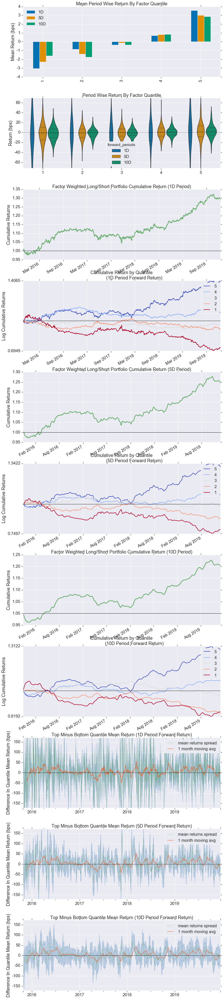

Information Analysis


,1D,5D,10D
IC Mean,0.01200000,0.02400000,0.02700000
IC Std.,0.12000000,0.12500000,0.12100000
Risk-Adjusted IC,0.10000000,0.18800000,0.22000000
t-stat(IC),3.19800000,5.99300000,7.00900000
p-value(IC),0.00100000,0.00000000,0.00000000
IC Skew,0.01800000,0.04800000,0.02800000
IC Kurtosis,0.13900000,0.12600000,-0.23900000


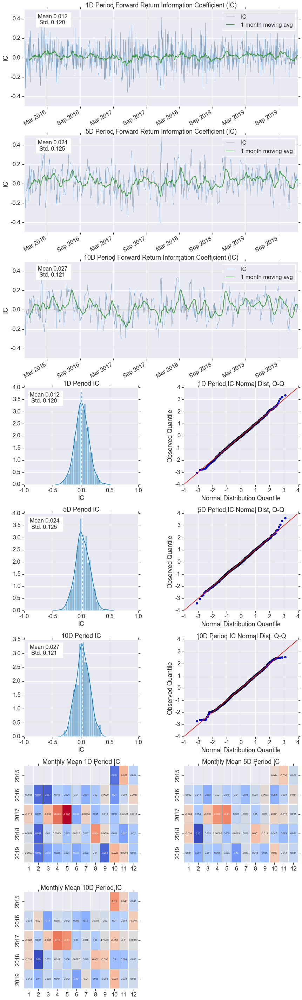

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.46800000,0.06100000,0.26400000
Quantile 2 Mean Turnover,0.70600000,0.13200000,0.53500000
Quantile 3 Mean Turnover,0.73600000,0.14900000,0.58100000
Quantile 4 Mean Turnover,0.70800000,0.13300000,0.53600000
Quantile 5 Mean Turnover,0.47800000,0.06200000,0.26700000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.99500000,0.89900000,0.66900000


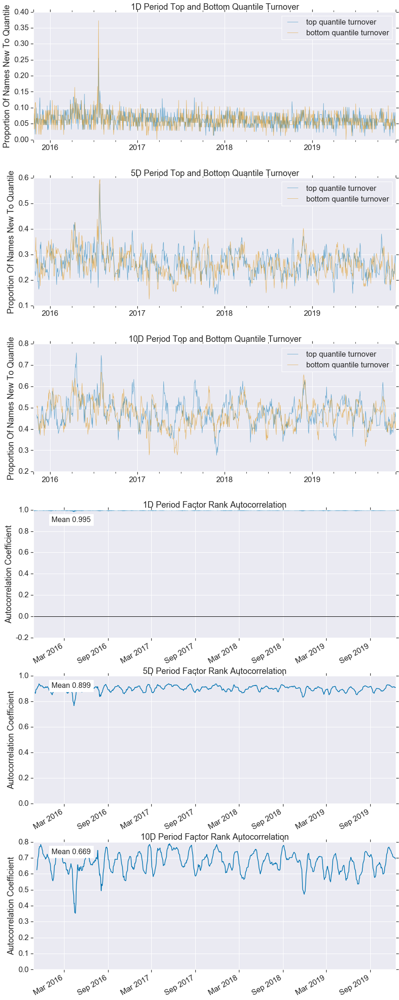

adv_20d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72847588,-0.71391517,-1.26680671,0.22055080,77931,20.10105856
2,-1.06309822,-0.04867603,-0.58806309,0.21081879,77335,19.94732987
3,-0.38329392,0.59222509,0.08219537,0.20751147,77352,19.95171475
4,0.27481451,1.19880690,0.74468813,0.19911557,77335,19.94732987
5,0.98198074,1.72847588,1.40469354,0.19172310,77743,20.05256696


Returns Analysis


,1D,5D,10D
Ann. alpha,-0.07800000,-0.07900000,-0.07900000
beta,0.00300000,-0.02300000,-0.04700000
Mean Period Wise Return Top Quantile (bps),-3.41100000,-3.67400000,-3.95700000
Mean Period Wise Return Bottom Quantile (bps),3.27500000,3.23500000,3.09800000
Mean Period Wise Spread (bps),-7.17800000,-7.40400000,-7.52100000


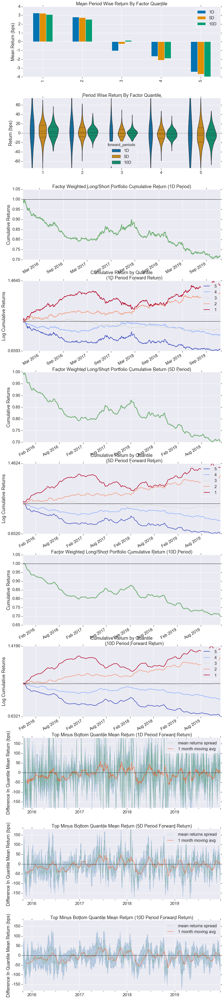

Information Analysis


,1D,5D,10D
IC Mean,-0.01500000,-0.03300000,-0.04600000
IC Std.,0.14500000,0.16200000,0.16600000
Risk-Adjusted IC,-0.10100000,-0.20500000,-0.27800000
t-stat(IC),-3.20600000,-6.52800000,-8.86500000
p-value(IC),0.00100000,0.00000000,0.00000000
IC Skew,0.08100000,0.16100000,0.03900000
IC Kurtosis,0.04300000,-0.23300000,-0.42600000


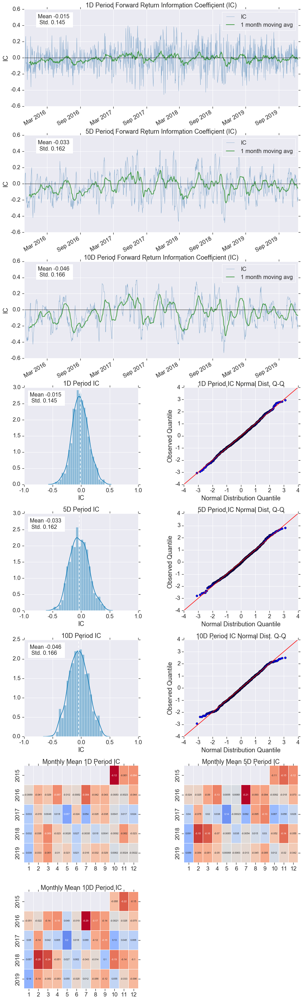

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.18900000,0.03100000,0.11100000
Quantile 2 Mean Turnover,0.36600000,0.06400000,0.22400000
Quantile 3 Mean Turnover,0.40500000,0.07000000,0.24900000
Quantile 4 Mean Turnover,0.35200000,0.05900000,0.21200000
Quantile 5 Mean Turnover,0.16300000,0.02800000,0.09600000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.99900000,0.98400000,0.95600000


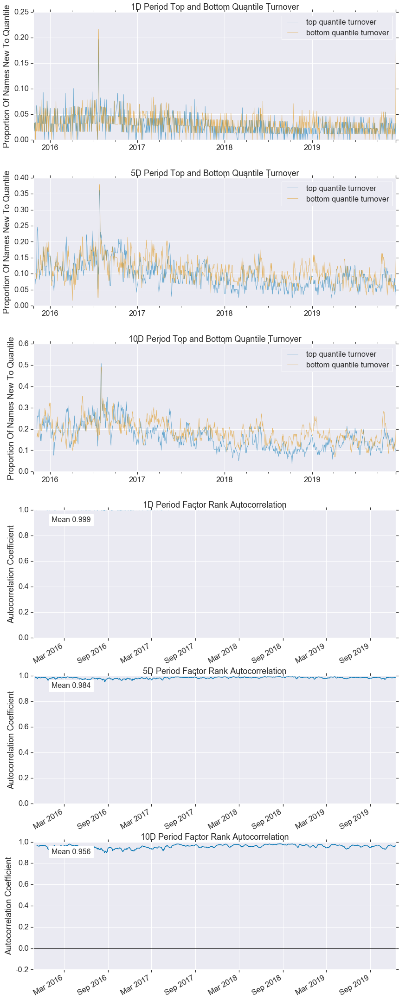

adv_120d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72847588,-0.71391517,-1.30970718,0.22077033,77931,20.10105856
2,-1.06449187,-0.03245069,-0.60191970,0.21101458,77335,19.94732987
3,-0.38329392,0.62467577,0.07778175,0.20676355,77352,19.95171475
4,0.28204647,1.21484445,0.74043358,0.19927066,77335,19.94732987
5,0.99232293,1.72847588,1.40606229,0.19181104,77743,20.05256696


Returns Analysis


,1D,5D,10D
Ann. alpha,-0.05900000,-0.06200000,-0.06400000
beta,-0.02700000,-0.04500000,-0.06800000
Mean Period Wise Return Top Quantile (bps),-1.74400000,-1.84500000,-2.06000000
Mean Period Wise Return Bottom Quantile (bps),2.85200000,3.42200000,3.58800000
Mean Period Wise Spread (bps),-4.81400000,-5.50800000,-5.85500000


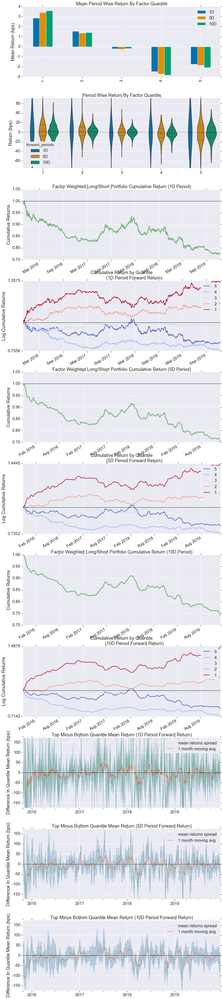

Information Analysis


,1D,5D,10D
IC Mean,-0.00600000,-0.02000000,-0.03100000
IC Std.,0.14000000,0.15300000,0.15600000
Risk-Adjusted IC,-0.04500000,-0.12900000,-0.19700000
t-stat(IC),-1.42700000,-4.11100000,-6.26000000
p-value(IC),0.15400000,0.00000000,0.00000000
IC Skew,0.08300000,0.01600000,-0.13400000
IC Kurtosis,0.05600000,-0.23400000,-0.04200000


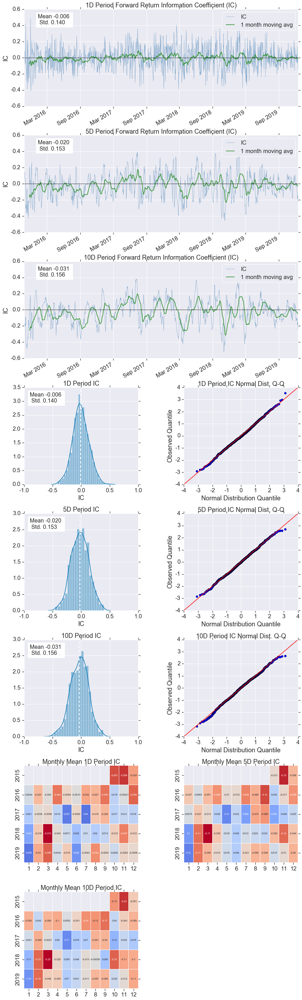

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.09900000,0.01700000,0.05800000
Quantile 2 Mean Turnover,0.15000000,0.02700000,0.08800000
Quantile 3 Mean Turnover,0.16100000,0.02900000,0.09400000
Quantile 4 Mean Turnover,0.13700000,0.02500000,0.08100000
Quantile 5 Mean Turnover,0.06800000,0.01300000,0.04100000


,1D,5D,10D
Mean Factor Rank Autocorrelation,1.00000000,0.99800000,0.99500000


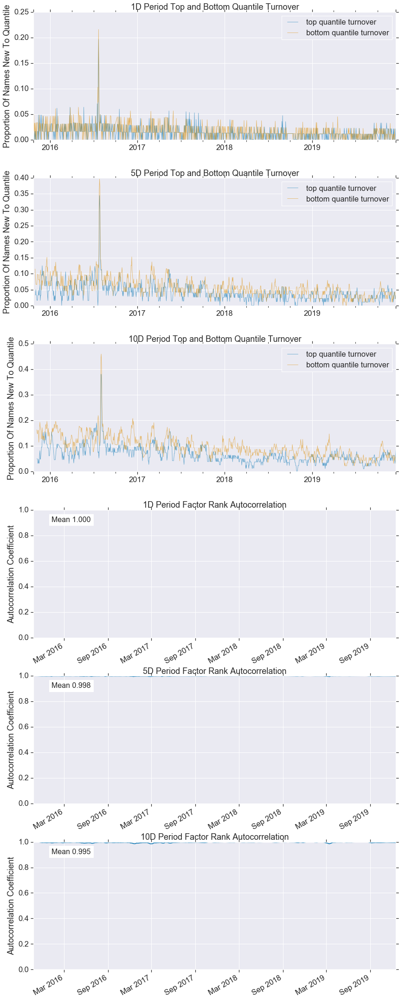

Overnight_Sentiment_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72847588,-0.81723749,-1.37071222,0.20311211,77931,20.10105856
2,-1.19078812,-0.06098787,-0.68970070,0.19943076,77335,19.94732987
3,-0.55989701,0.58954943,-0.01857731,0.20521383,77352,19.95171475
4,0.13294282,1.16690129,0.66491458,0.21708726,77335,19.94732987
5,0.78692922,1.72847588,1.37045720,0.21035029,77743,20.05256696


Returns Analysis


,1D,5D,10D
Ann. alpha,-0.01200000,-0.00200000,-0.00400000
beta,-0.04400000,-0.05100000,-0.05300000
Mean Period Wise Return Top Quantile (bps),-0.27800000,-0.32100000,-0.41000000
Mean Period Wise Return Bottom Quantile (bps),0.74900000,-0.12200000,-0.03000000
Mean Period Wise Spread (bps),-1.12700000,-0.22400000,-0.36400000


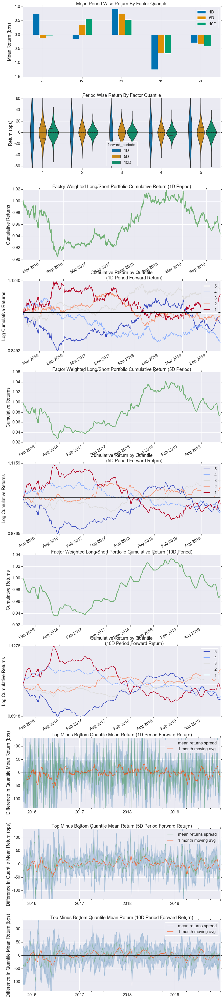

Information Analysis


,1D,5D,10D
IC Mean,0.00400000,0.00500000,0.00400000
IC Std.,0.09700000,0.09900000,0.10000000
Risk-Adjusted IC,0.04000000,0.04700000,0.04300000
t-stat(IC),1.26600000,1.48300000,1.35600000
p-value(IC),0.20600000,0.13800000,0.17500000
IC Skew,-0.07000000,-0.31600000,-0.27900000
IC Kurtosis,1.60900000,1.40900000,1.39200000


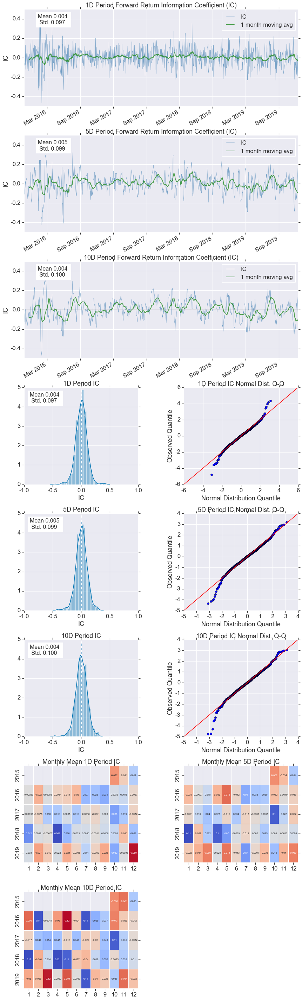

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.60000000,0.09200000,0.37800000
Quantile 2 Mean Turnover,0.75900000,0.20700000,0.65300000
Quantile 3 Mean Turnover,0.78100000,0.24100000,0.69700000
Quantile 4 Mean Turnover,0.76000000,0.21800000,0.66900000
Quantile 5 Mean Turnover,0.64600000,0.09800000,0.40600000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.98700000,0.76100000,0.38000000


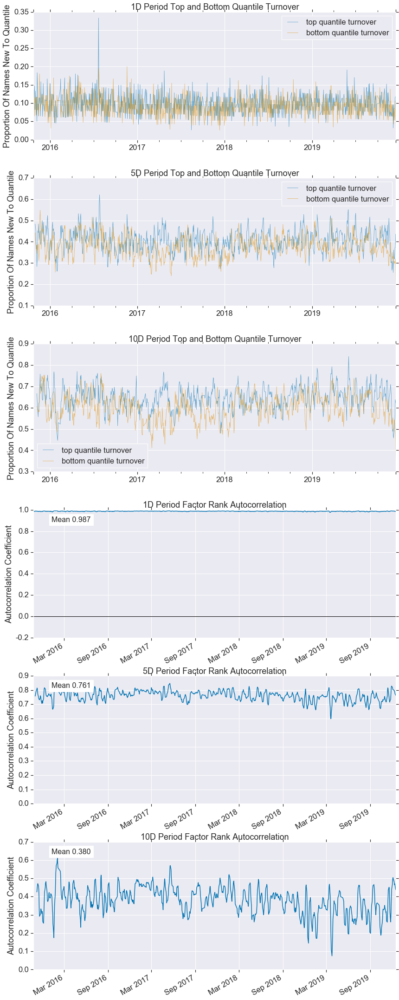

增强_ALPHA
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.04753831,-0.00722917,-0.02044391,0.00611657,77931,20.10105856
2,-0.01846573,0.00216666,-0.00848125,0.00322400,77335,19.94732987
3,-0.00993537,0.01304824,-0.00053379,0.00296365,77352,19.95171475
4,-0.00342013,0.02552131,0.00673418,0.00393205,77335,19.94732987
5,0.00185531,0.05792990,0.01979706,0.01000727,77743,20.05256696


Returns Analysis


,1D,5D,10D
Ann. alpha,0.19800000,0.17200000,0.14900000
beta,-0.17000000,-0.17000000,-0.17100000
Mean Period Wise Return Top Quantile (bps),8.37600000,7.25000000,6.05900000
Mean Period Wise Return Bottom Quantile (bps),-8.74300000,-7.32000000,-6.40500000
Mean Period Wise Spread (bps),17.48100000,14.87900000,12.88900000


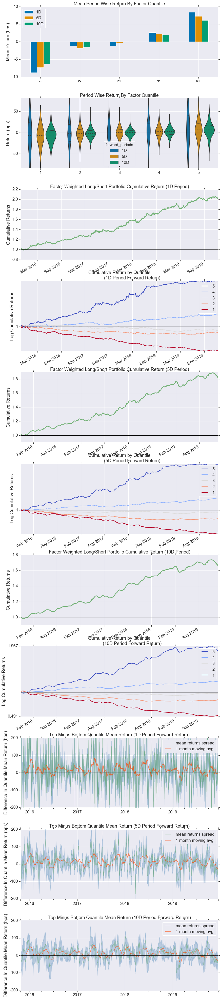

Information Analysis


,1D,5D,10D
IC Mean,0.04300000,0.07600000,0.09300000
IC Std.,0.16600000,0.16800000,0.16700000
Risk-Adjusted IC,0.25700000,0.44900000,0.55700000
t-stat(IC),8.17000000,14.30900000,17.75000000
p-value(IC),0.00000000,0.00000000,0.00000000
IC Skew,-0.12000000,-0.09300000,-0.21200000
IC Kurtosis,-0.18600000,-0.50000000,-0.38400000


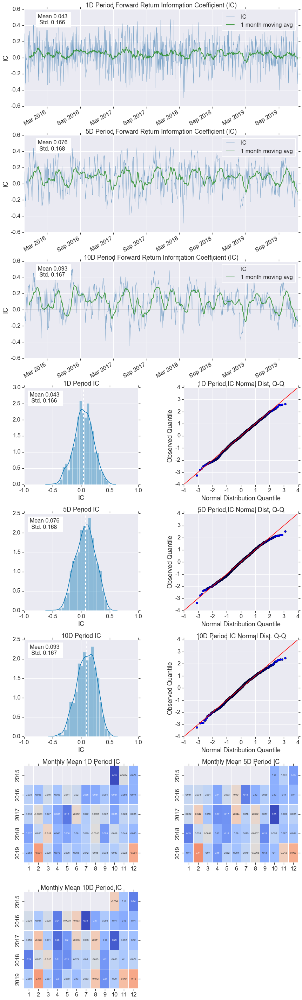

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.33700000,0.16200000,0.23100000
Quantile 2 Mean Turnover,0.57500000,0.37400000,0.44100000
Quantile 3 Mean Turnover,0.61500000,0.42800000,0.48700000
Quantile 4 Mean Turnover,0.57200000,0.39100000,0.44400000
Quantile 5 Mean Turnover,0.31600000,0.19100000,0.21600000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.92400000,0.90500000,0.81400000


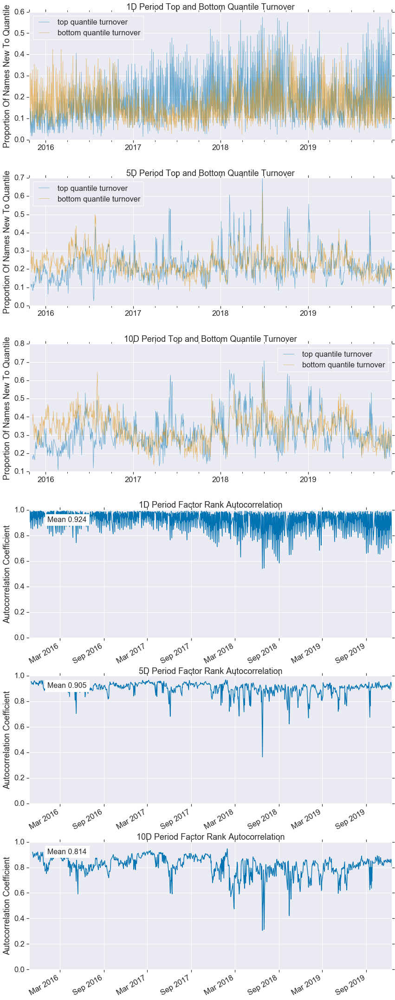

volatility_20d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72847588,-0.86960588,-1.39756953,0.18925030,77931,20.10105856
2,-1.23657787,-0.23976788,-0.73994018,0.19613535,77335,19.94732987
3,-0.64369807,0.36523766,-0.07149330,0.20064895,77352,19.95171475
4,0.07181695,1.07772379,0.61465596,0.20810119,77335,19.94732987
5,0.73686489,1.72847588,1.33386415,0.22032852,77743,20.05256696


Returns Analysis


,1D,5D,10D
Ann. alpha,-0.01300000,-0.01800000,-0.02500000
beta,0.22100000,0.21700000,0.21500000
Mean Period Wise Return Top Quantile (bps),-1.49400000,-1.38400000,-1.50700000
Mean Period Wise Return Bottom Quantile (bps),-1.70800000,-1.36800000,-0.48300000
Mean Period Wise Spread (bps),-0.53600000,-0.75300000,-1.77400000


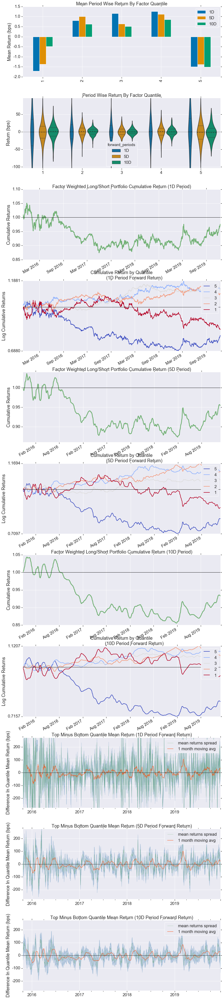

Information Analysis


,1D,5D,10D
IC Mean,-0.01900000,-0.03200000,-0.04200000
IC Std.,0.21400000,0.20500000,0.20100000
Risk-Adjusted IC,-0.09100000,-0.15700000,-0.21000000
t-stat(IC),-2.89000000,-4.98600000,-6.70200000
p-value(IC),0.00400000,0.00000000,0.00000000
IC Skew,0.23400000,0.13600000,0.21800000
IC Kurtosis,-0.13000000,-0.41200000,-0.24600000


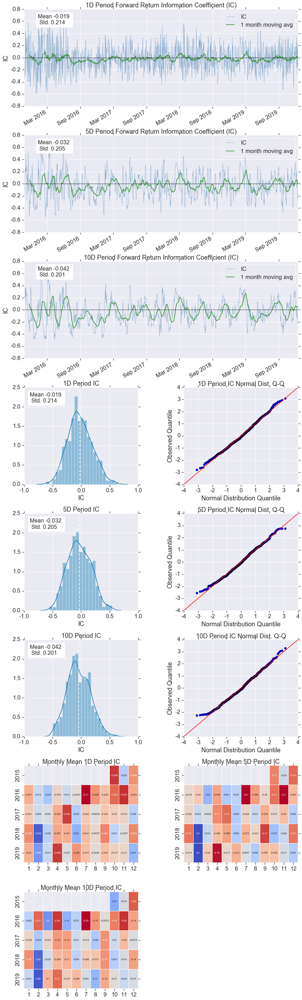

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.32100000,0.08000000,0.21500000
Quantile 2 Mean Turnover,0.59300000,0.17700000,0.44000000
Quantile 3 Mean Turnover,0.63400000,0.20000000,0.48500000
Quantile 4 Mean Turnover,0.60900000,0.18000000,0.45400000
Quantile 5 Mean Turnover,0.39400000,0.08700000,0.25400000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.97800000,0.89100000,0.78100000


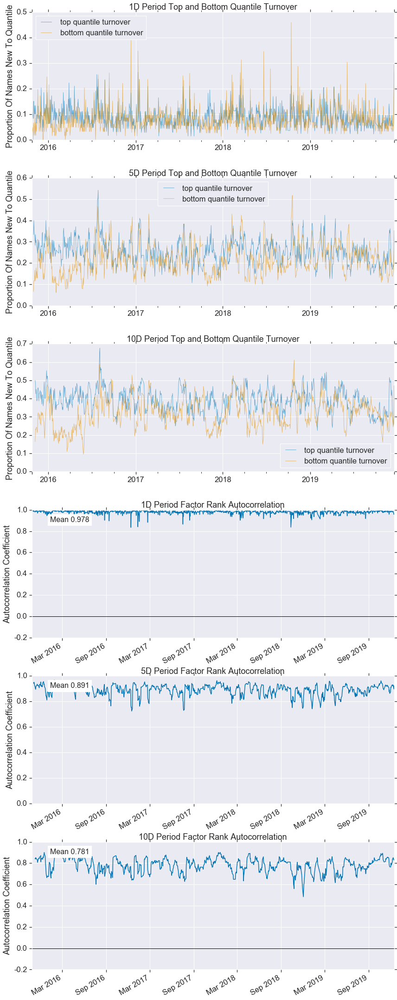

Momentum_1YR
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72841586,-0.98376749,-1.38274441,0.20136127,77931,20.10105856
2,-1.06660745,-0.28699800,-0.68932501,0.19989321,77335,19.94732987
3,-0.40089186,0.39024787,0.00171066,0.19971608,77352,19.95171475
4,0.28867637,1.06232827,0.69089433,0.19934624,77335,19.94732987
5,0.97653146,1.72841586,1.38237176,0.20103605,77743,20.05256696


Returns Analysis


,1D,5D,10D
Ann. alpha,-0.03600000,-0.03400000,-0.03000000
beta,-0.02200000,-0.04300000,-0.05800000
Mean Period Wise Return Top Quantile (bps),-1.79200000,-1.21800000,-1.19800000
Mean Period Wise Return Bottom Quantile (bps),1.02400000,1.30200000,1.16700000
Mean Period Wise Spread (bps),-3.56300000,-3.16400000,-2.94000000


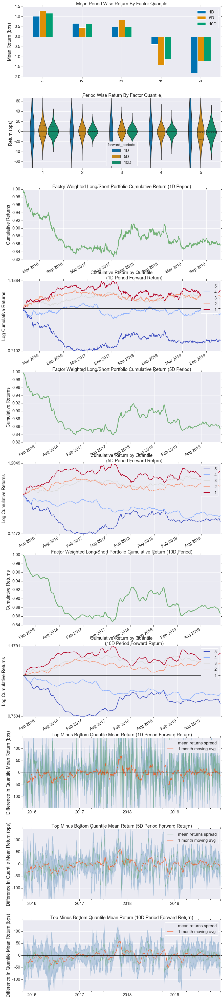

Information Analysis


,1D,5D,10D
IC Mean,0.00000000,-0.00000000,-0.00200000
IC Std.,0.11300000,0.12700000,0.12500000
Risk-Adjusted IC,0.00200000,-0.00200000,-0.01900000
t-stat(IC),0.06300000,-0.06000000,-0.60600000
p-value(IC),0.95000000,0.95200000,0.54500000
IC Skew,0.08700000,0.13400000,0.03800000
IC Kurtosis,0.42100000,0.24700000,0.13700000


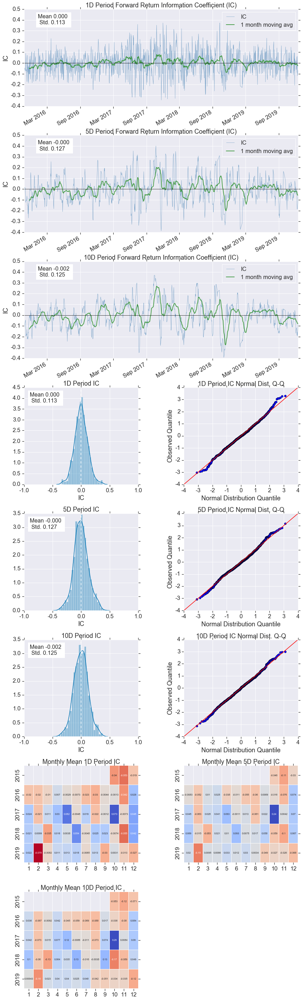

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.18900000,0.05500000,0.13200000
Quantile 2 Mean Turnover,0.36400000,0.12000000,0.26900000
Quantile 3 Mean Turnover,0.40100000,0.14100000,0.30600000
Quantile 4 Mean Turnover,0.36500000,0.12500000,0.27400000
Quantile 5 Mean Turnover,0.19700000,0.05900000,0.13800000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.99300000,0.96500000,0.93600000


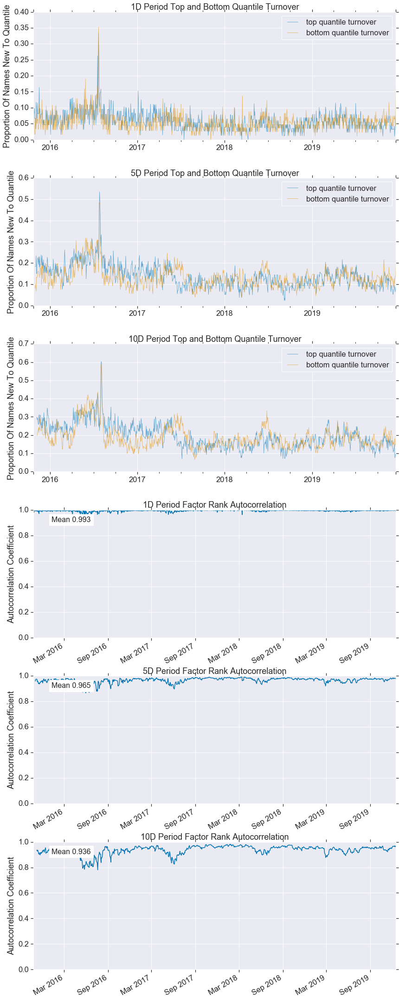

Mean_Reversion_Sector_Neutral_Smoothed    0.01204928
adv_20d                                  -0.01456911
adv_120d                                 -0.00627115
Overnight_Sentiment_Smoothed              0.00386197
增强_ALPHA                                  0.04263671
volatility_20d                           -0.01938005
Momentum_1YR                              0.00022414
dtype: float64


In [31]:
factor_IC = show_sample_results(all_factors, X_train, clf, factor_names,max_loss=0.4)

In [ ]:
factor_IC = show_information_coefficient(all_factors, X_train, clf, factor_names,max_loss=0.4)

[ 0.50233573  0.49766427]
Cleaning Data...

Dropped 9.1% entries from factor data: 9.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 40.0%, not exceeded: OK!
Dropped 9.1% entries from factor data: 9.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 40.0%, not exceeded: OK!
Dropped 9.1% entries from factor data: 9.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 40.0%, not exceeded: OK!
Dropped 9.1% entries from factor data: 9.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 40.0%, not exceeded: OK!
Dropped 9.1% entries from factor data: 9.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss

,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72855524,-0.98924244,-1.37622083,0.20285322,8964,20.08379450
2,-1.04972990,-0.30627791,-0.68451850,0.19824971,8905,19.95160531
3,-0.37822413,0.37943585,-0.00130018,0.19845299,8909,19.96056729
4,0.25804076,1.06237342,0.68700263,0.20103061,8905,19.95160531
5,0.99328018,1.72855524,1.38433200,0.20212320,8950,20.05242758


Returns Analysis


,1D,5D,10D
Ann. alpha,0.05600000,0.04000000,0.05100000
beta,-0.06600000,-0.06500000,-0.09400000
Mean Period Wise Return Top Quantile (bps),-1.28400000,-2.09400000,-2.50100000
Mean Period Wise Return Bottom Quantile (bps),-1.14000000,-1.81400000,-2.29700000
Mean Period Wise Spread (bps),-0.76600000,-0.45600000,-0.15600000


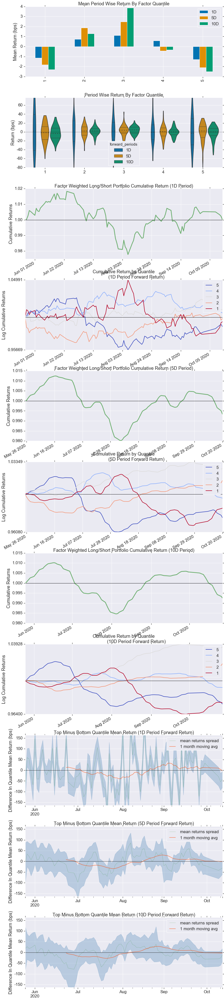

Information Analysis


,1D,5D,10D
IC Mean,0.00900000,0.02000000,0.02400000
IC Std.,0.09100000,0.09100000,0.09400000
Risk-Adjusted IC,0.09400000,0.21900000,0.25100000
t-stat(IC),0.91600000,2.12800000,2.43500000
p-value(IC),0.36200000,0.03600000,0.01700000
IC Skew,0.23300000,-0.34100000,-0.42300000
IC Kurtosis,-0.52100000,-0.57400000,-0.86900000


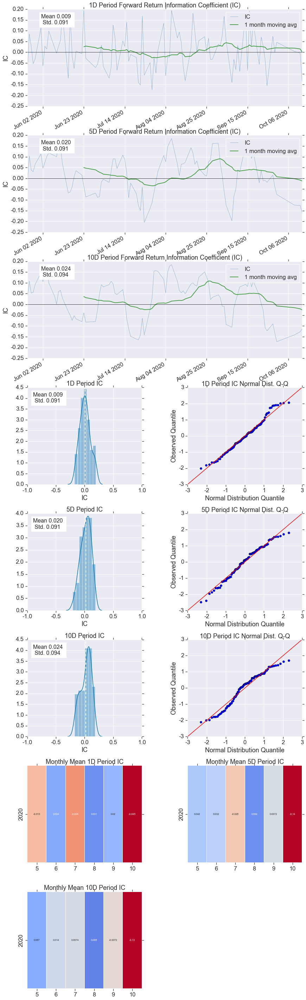

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.45000000,0.06000000,0.24600000
Quantile 2 Mean Turnover,0.70200000,0.13100000,0.53700000
Quantile 3 Mean Turnover,0.72500000,0.14900000,0.57500000
Quantile 4 Mean Turnover,0.71500000,0.12900000,0.53400000
Quantile 5 Mean Turnover,0.44100000,0.05900000,0.24700000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.99500000,0.90400000,0.67700000


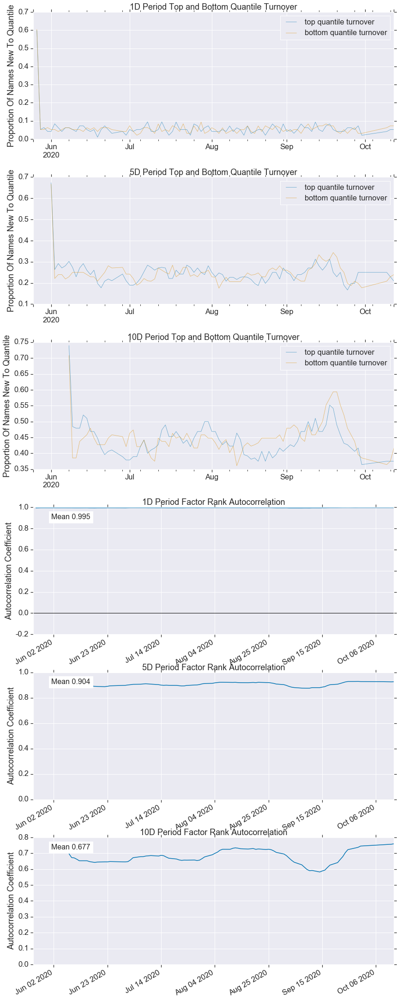

adv_20d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72857628,-0.99272049,-1.37262775,0.20068668,8964,20.08379450
2,-1.05536106,-0.30668165,-0.68268308,0.20003722,8905,19.95160531
3,-0.46632233,0.37487347,0.00480646,0.19897670,8909,19.96056729
4,0.23491425,1.06079631,0.69180721,0.20081022,8905,19.95160531
5,1.01473891,1.72858323,1.38830600,0.19992870,8950,20.05242758


Returns Analysis


,1D,5D,10D
Ann. alpha,-0.37900000,-0.37300000,-0.36800000
beta,0.04800000,0.01500000,-0.04200000
Mean Period Wise Return Top Quantile (bps),-13.57800000,-11.83300000,-11.61300000
Mean Period Wise Return Bottom Quantile (bps),30.55100000,31.84900000,33.83800000
Mean Period Wise Spread (bps),-43.37600000,-43.90500000,-45.34100000


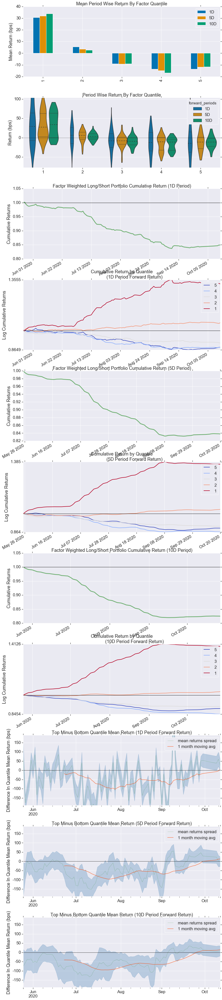

Information Analysis


,1D,5D,10D
IC Mean,-0.03800000,-0.07400000,-0.10500000
IC Std.,0.10100000,0.11800000,0.13200000
Risk-Adjusted IC,-0.37700000,-0.63200000,-0.79600000
t-stat(IC),-3.65200000,-6.12700000,-7.71800000
p-value(IC),0.00000000,0.00000000,0.00000000
IC Skew,0.17800000,0.01500000,0.03400000
IC Kurtosis,0.14500000,-0.70700000,-0.88500000


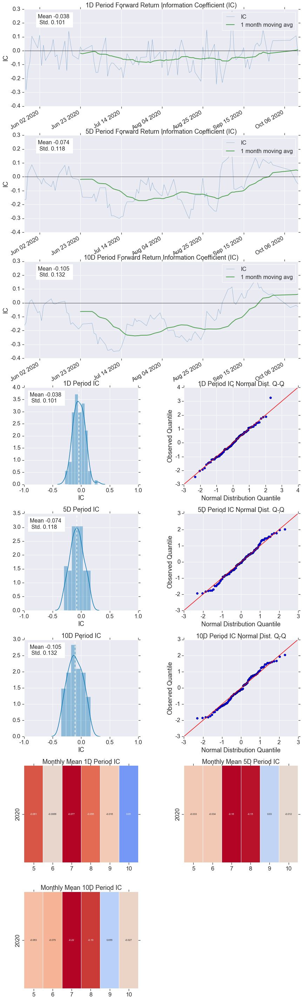

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.31400000,0.04900000,0.17800000
Quantile 2 Mean Turnover,0.53500000,0.10100000,0.35600000
Quantile 3 Mean Turnover,0.53600000,0.10000000,0.35500000
Quantile 4 Mean Turnover,0.43100000,0.07100000,0.25800000
Quantile 5 Mean Turnover,0.17300000,0.03100000,0.09900000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.99700000,0.96200000,0.88500000


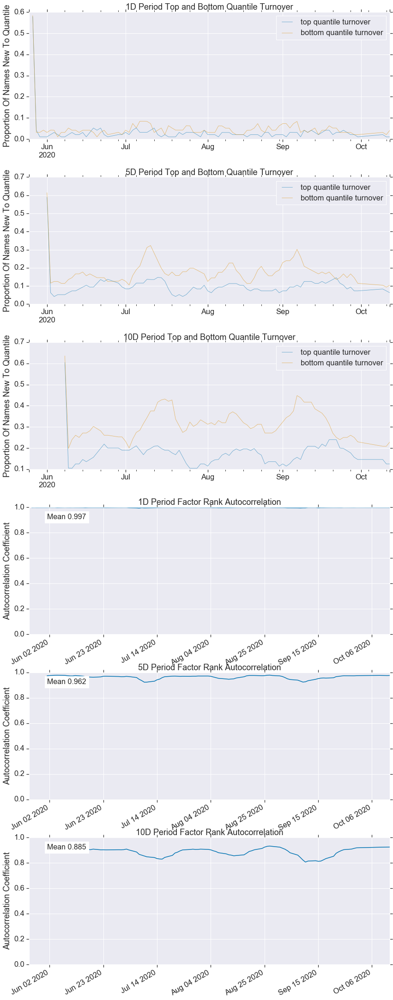

adv_120d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72858323,-0.98126465,-1.36016004,0.20951000,8964,20.08379450
2,-1.02743100,-0.29851036,-0.66088106,0.19769023,8905,19.95160531
3,-0.42424813,0.38181557,0.02110125,0.19696533,8909,19.96056729
4,0.26296372,1.08341052,0.70495095,0.19847423,8905,19.95160531
5,1.03432396,1.72858323,1.39476581,0.19521413,8950,20.05242758


Returns Analysis


,1D,5D,10D
Ann. alpha,-0.39900000,-0.39200000,-0.38100000
beta,0.04200000,0.00200000,-0.05100000
Mean Period Wise Return Top Quantile (bps),-8.10300000,-8.64500000,-9.67600000
Mean Period Wise Return Bottom Quantile (bps),40.01200000,41.44300000,41.81800000
Mean Period Wise Spread (bps),-48.32500000,-50.38700000,-51.47900000


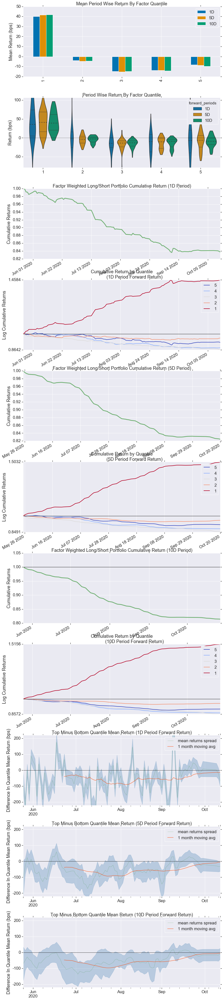

Information Analysis


,1D,5D,10D
IC Mean,-0.02800000,-0.06300000,-0.09000000
IC Std.,0.09100000,0.09800000,0.10100000
Risk-Adjusted IC,-0.31000000,-0.63700000,-0.89600000
t-stat(IC),-3.00200000,-6.17700000,-8.68900000
p-value(IC),0.00300000,0.00000000,0.00000000
IC Skew,0.53500000,0.10100000,-0.18000000
IC Kurtosis,0.75200000,-0.28600000,-0.19900000


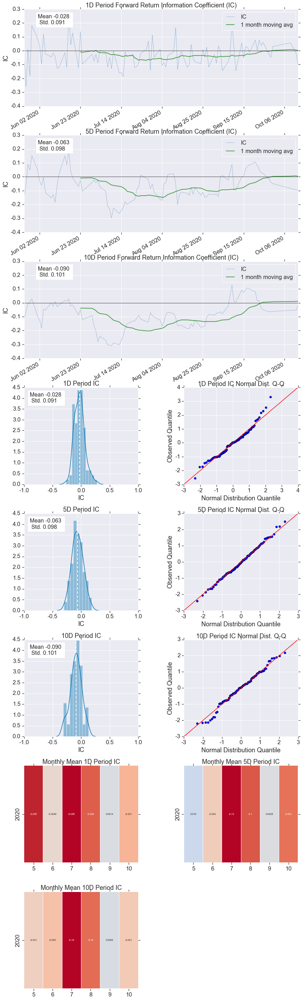

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.12200000,0.02300000,0.06800000
Quantile 2 Mean Turnover,0.21900000,0.03500000,0.12100000
Quantile 3 Mean Turnover,0.19400000,0.03400000,0.10800000
Quantile 4 Mean Turnover,0.12400000,0.02400000,0.06900000
Quantile 5 Mean Turnover,0.04500000,0.01300000,0.02800000


,1D,5D,10D
Mean Factor Rank Autocorrelation,1.00000000,0.99700000,0.98800000


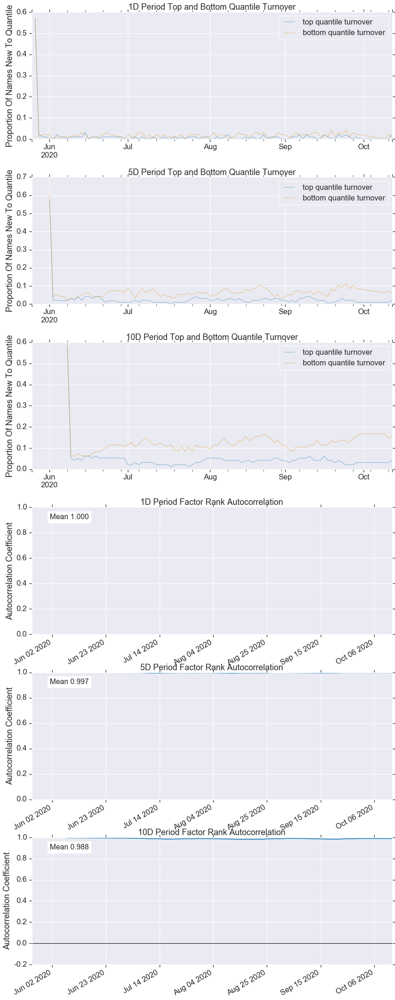

Overnight_Sentiment_Smoothed
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72858323,-0.98974532,-1.37099427,0.20689968,8964,20.08379450
2,-1.04133632,-0.29851036,-0.66842131,0.20070814,8905,19.95160531
3,-0.48735942,0.38875768,0.01795979,0.19832901,8909,19.96056729
4,-0.01051855,1.06214151,0.69939385,0.19851564,8905,19.95160531
5,0.73279223,1.72858323,1.38187653,0.19879180,8950,20.05242758


Returns Analysis


,1D,5D,10D
Ann. alpha,0.13500000,0.11400000,0.10100000
beta,-0.01800000,-0.01200000,0.01500000
Mean Period Wise Return Top Quantile (bps),4.16400000,5.07600000,5.58500000
Mean Period Wise Return Bottom Quantile (bps),-5.18100000,-5.27700000,-5.51800000
Mean Period Wise Spread (bps),9.25900000,10.15600000,11.01200000


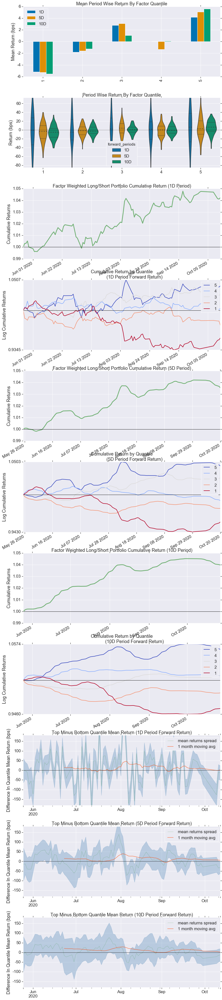

Information Analysis


,1D,5D,10D
IC Mean,0.02200000,0.03300000,0.04100000
IC Std.,0.09600000,0.09100000,0.07700000
Risk-Adjusted IC,0.22900000,0.35700000,0.52600000
t-stat(IC),2.22400000,3.46200000,5.09600000
p-value(IC),0.02900000,0.00100000,0.00000000
IC Skew,-0.08800000,-0.22900000,-0.38300000
IC Kurtosis,-0.11500000,-0.22400000,-0.03000000


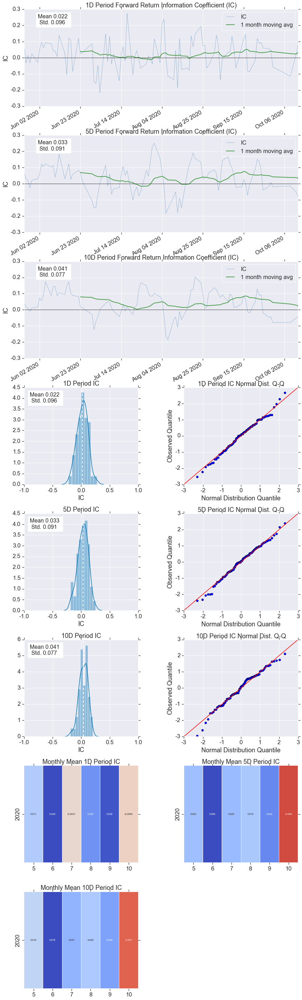

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.60400000,0.09500000,0.37700000
Quantile 2 Mean Turnover,0.75400000,0.21400000,0.65700000
Quantile 3 Mean Turnover,0.76900000,0.24500000,0.69700000
Quantile 4 Mean Turnover,0.75700000,0.21800000,0.66300000
Quantile 5 Mean Turnover,0.63200000,0.09900000,0.39600000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.98600000,0.75000000,0.35600000


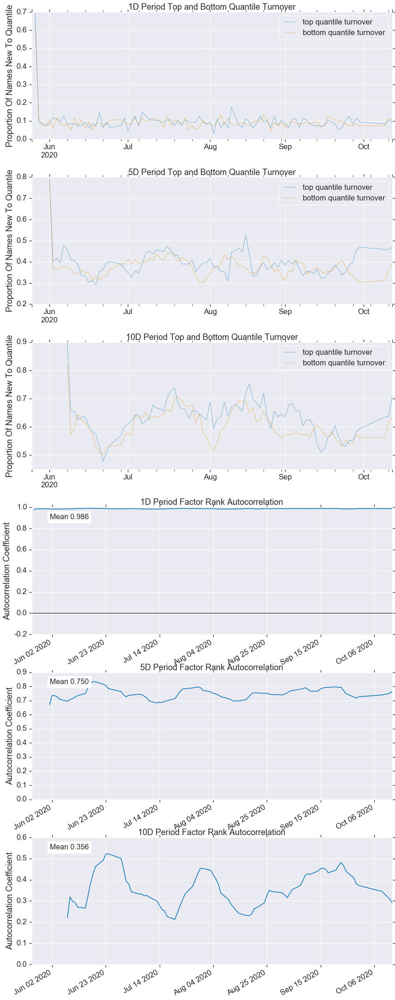

增强_ALPHA
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.04349983,-0.00715779,-0.01870108,0.00576101,8964,20.08379450
2,-0.01509660,-0.00056902,-0.00801491,0.00273558,8905,19.95160531
3,-0.00713402,0.00679905,-0.00045383,0.00260380,8909,19.96056729
4,-0.00066380,0.01756216,0.00760493,0.00345867,8905,19.95160531
5,0.00850376,0.05058136,0.02263436,0.00804867,8950,20.05242758


Returns Analysis


,1D,5D,10D
Ann. alpha,0.37800000,0.41900000,0.40700000
beta,-0.09400000,-0.07500000,-0.02300000
Mean Period Wise Return Top Quantile (bps),14.76700000,14.47700000,16.03100000
Mean Period Wise Return Bottom Quantile (bps),-10.71700000,-13.17400000,-14.41800000
Mean Period Wise Spread (bps),24.99800000,27.71100000,30.35200000


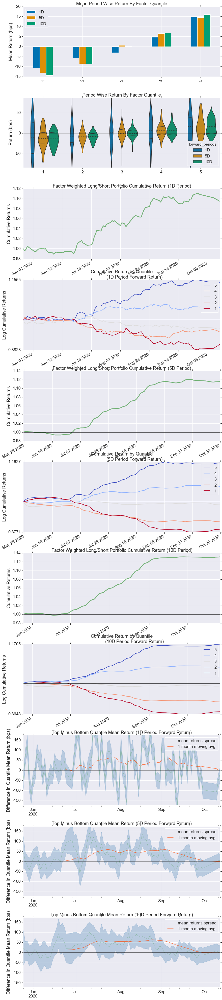

Information Analysis


,1D,5D,10D
IC Mean,0.04100000,0.07900000,0.11100000
IC Std.,0.10600000,0.11200000,0.11400000
Risk-Adjusted IC,0.38400000,0.70300000,0.97200000
t-stat(IC),3.72600000,6.81300000,9.42300000
p-value(IC),0.00000000,0.00000000,0.00000000
IC Skew,0.04800000,0.35600000,0.34500000
IC Kurtosis,-0.41700000,-0.21300000,-0.54500000


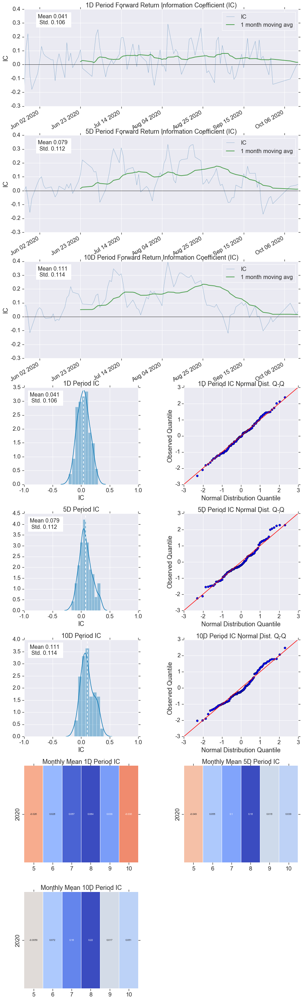

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.40200000,0.17200000,0.26400000
Quantile 2 Mean Turnover,0.63100000,0.37200000,0.48100000
Quantile 3 Mean Turnover,0.63900000,0.39700000,0.50100000
Quantile 4 Mean Turnover,0.59700000,0.32500000,0.44800000
Quantile 5 Mean Turnover,0.33800000,0.12600000,0.21500000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.94700000,0.88100000,0.73200000


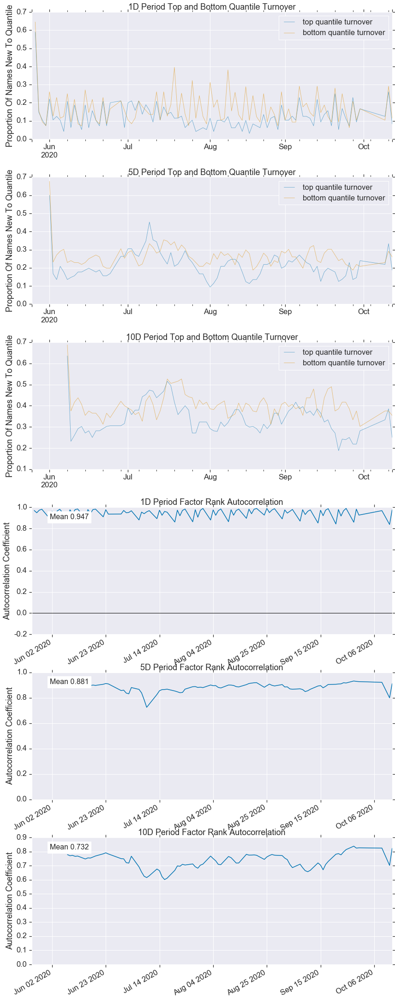

volatility_20d
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72858323,-1.02873531,-1.38388874,0.19849383,8964,20.08379450
2,-1.31481859,-0.34850187,-0.70320871,0.19652122,8905,19.95160531
3,-0.62760674,0.34016297,-0.02595845,0.19712678,8909,19.96056729
4,0.21387716,1.03853558,0.65923470,0.20009599,8905,19.95160531
5,0.93615084,1.72858323,1.36775604,0.21127571,8950,20.05242758


Returns Analysis


,1D,5D,10D
Ann. alpha,-0.03200000,-0.05000000,-0.06800000
beta,0.16100000,0.13500000,0.09500000
Mean Period Wise Return Top Quantile (bps),5.39500000,3.76600000,-0.15900000
Mean Period Wise Return Bottom Quantile (bps),-5.16100000,-2.00200000,0.56800000
Mean Period Wise Spread (bps),11.66000000,6.15800000,-0.64900000


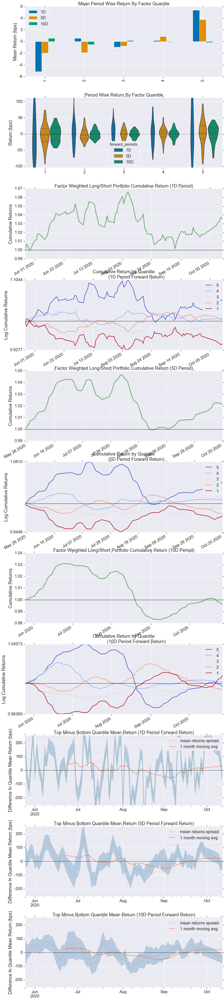

Information Analysis


,1D,5D,10D
IC Mean,-0.02000000,-0.03300000,-0.05400000
IC Std.,0.17900000,0.18300000,0.17700000
Risk-Adjusted IC,-0.11200000,-0.18100000,-0.30400000
t-stat(IC),-1.08200000,-1.75200000,-2.95200000
p-value(IC),0.28200000,0.08300000,0.00400000
IC Skew,0.22600000,0.06000000,-0.19100000
IC Kurtosis,-0.32900000,-0.76800000,-0.75900000


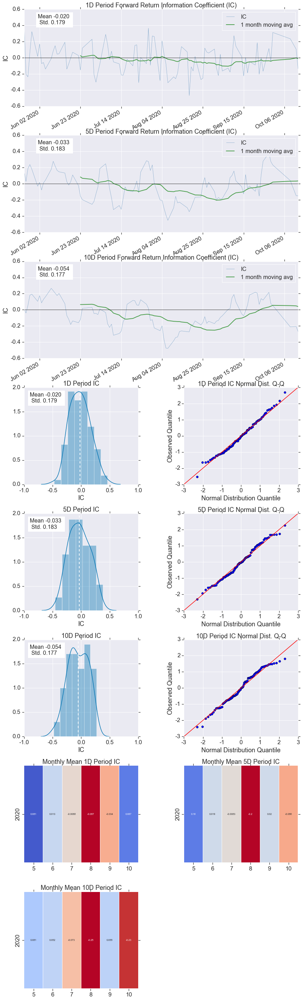

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.35900000,0.09100000,0.24200000
Quantile 2 Mean Turnover,0.61900000,0.19900000,0.47500000
Quantile 3 Mean Turnover,0.65000000,0.22100000,0.52200000
Quantile 4 Mean Turnover,0.62200000,0.18500000,0.46300000
Quantile 5 Mean Turnover,0.36700000,0.08100000,0.22800000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.97800000,0.87700000,0.74200000


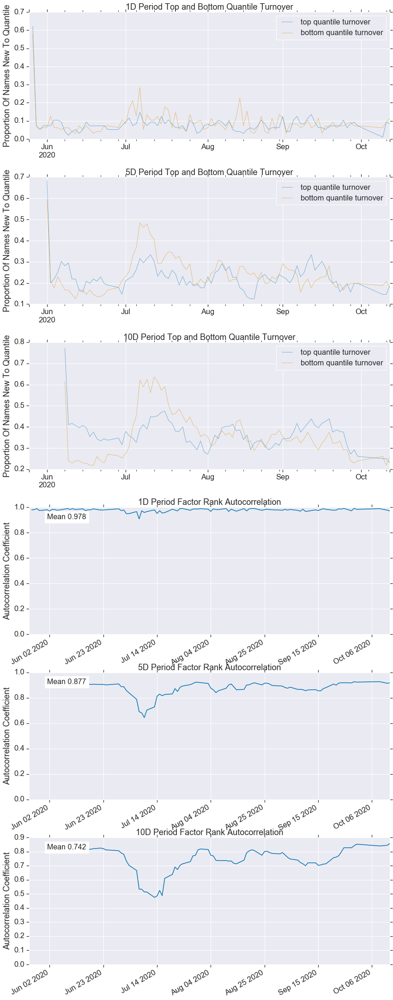

Momentum_1YR
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-1.72847588,-0.96588370,-1.38383197,0.20101893,8964,20.08379450
2,-1.04140234,-0.20334394,-0.68892400,0.20033198,8905,19.95160531
3,-0.35575394,0.35575394,0.00184829,0.19921245,8909,19.96056729
4,0.31227819,1.04284119,0.69143685,0.19937651,8905,19.95160531
5,0.95135914,1.72847588,1.38456190,0.20074145,8950,20.05242758


Returns Analysis


,1D,5D,10D
Ann. alpha,-0.15700000,-0.17300000,-0.18900000
beta,0.10900000,0.13300000,0.13600000
Mean Period Wise Return Top Quantile (bps),-9.86700000,-10.55200000,-12.33000000
Mean Period Wise Return Bottom Quantile (bps),0.45200000,-0.40500000,1.23900000
Mean Period Wise Spread (bps),-9.63400000,-10.15000000,-13.82700000


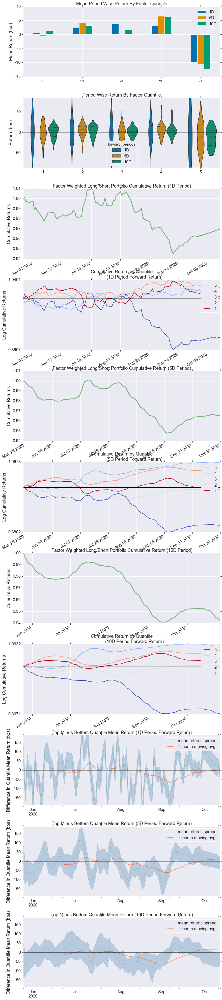

Information Analysis


,1D,5D,10D
IC Mean,-0.01400000,-0.03000000,-0.04500000
IC Std.,0.10300000,0.12100000,0.12300000
Risk-Adjusted IC,-0.13700000,-0.24800000,-0.36400000
t-stat(IC),-1.32700000,-2.40100000,-3.52700000
p-value(IC),0.18800000,0.01800000,0.00100000
IC Skew,-0.20600000,0.04900000,0.14800000
IC Kurtosis,-0.13800000,-0.83100000,-1.16900000


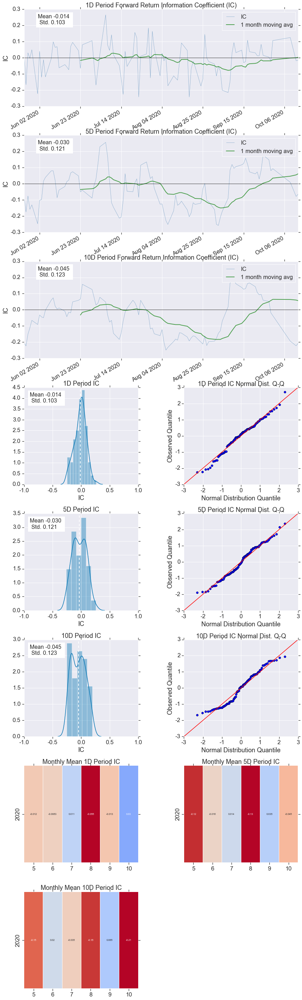

Turnover Analysis


,10D,1D,5D
Quantile 1 Mean Turnover,0.17400000,0.05700000,0.12600000
Quantile 2 Mean Turnover,0.37500000,0.12800000,0.27200000
Quantile 3 Mean Turnover,0.39900000,0.14800000,0.29500000
Quantile 4 Mean Turnover,0.37400000,0.12400000,0.26900000
Quantile 5 Mean Turnover,0.18600000,0.05700000,0.12600000


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.99300000,0.96800000,0.93600000


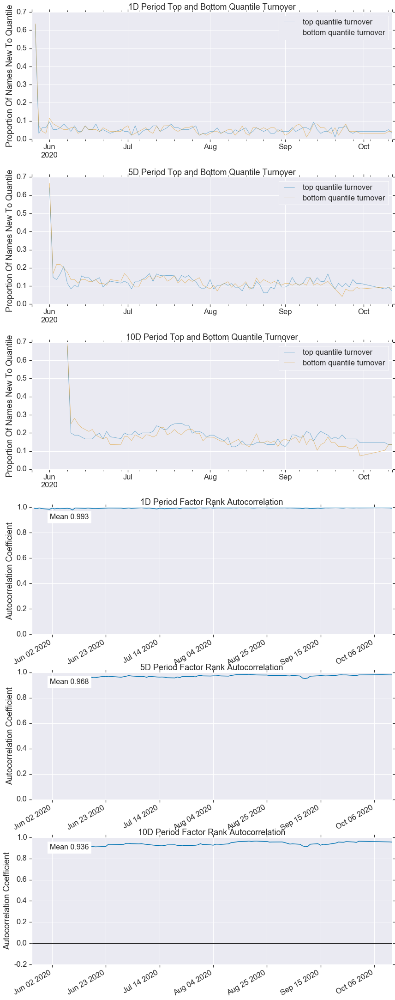

Mean_Reversion_Sector_Neutral_Smoothed    0.00861953
adv_20d                                  -0.03802114
adv_120d                                 -0.02828789
Overnight_Sentiment_Smoothed              0.02195147
增强_ALPHA                                  0.04069671
volatility_20d                           -0.01994163
Momentum_1YR                             -0.01412282
dtype: float64


In [32]:
# X_train, X_valid, X_test, y_train, y_valid, y_test
factor_IC = show_sample_results(all_factors, X_test, clf, factor_names,max_loss=0.4)

In [33]:
factor_IC.mean()

Mean_Reversion_Sector_Neutral_Smoothed    0.00861953
adv_20d                                  -0.03802114
adv_120d                                 -0.02828789
Overnight_Sentiment_Smoothed              0.02195147
增强_ALPHA                                  0.04069671
volatility_20d                           -0.01994163
Momentum_1YR                             -0.01412282
dtype: float64

##### 验证集预测
训练处的模型，在验证集做预测。

[ 0.50224046  0.49775954]
Cleaning Data...

Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss

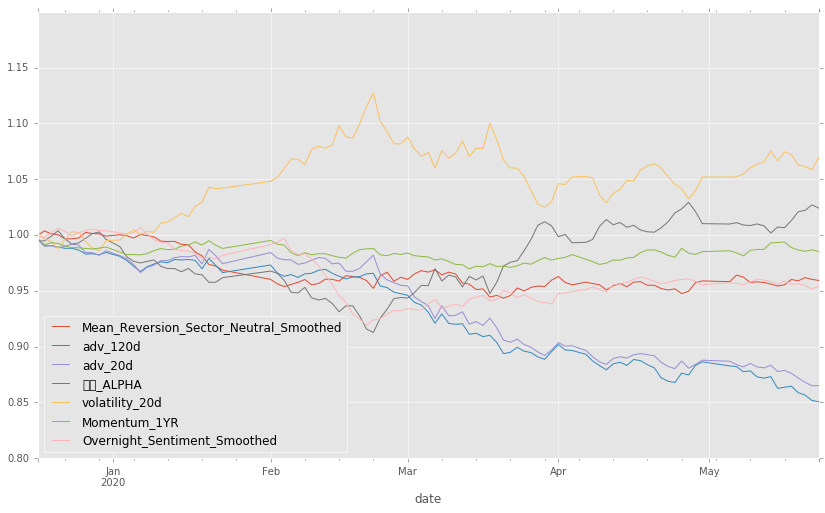

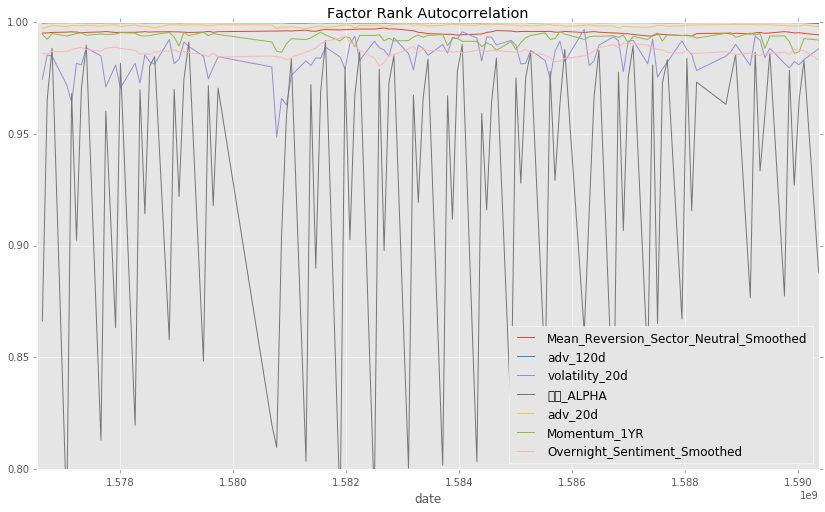

In [35]:
show_sample_results(all_factors, X_valid, clf, factor_names)

[ 0.50233573  0.49766427]
Cleaning Data...

Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss

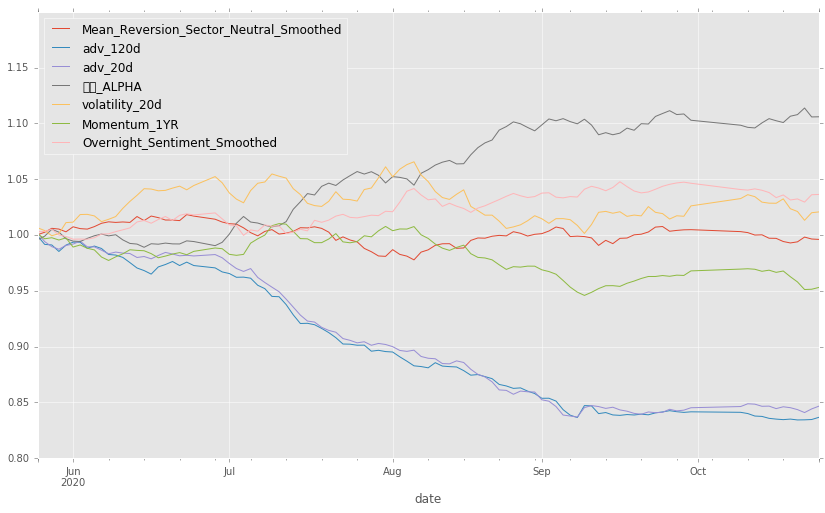

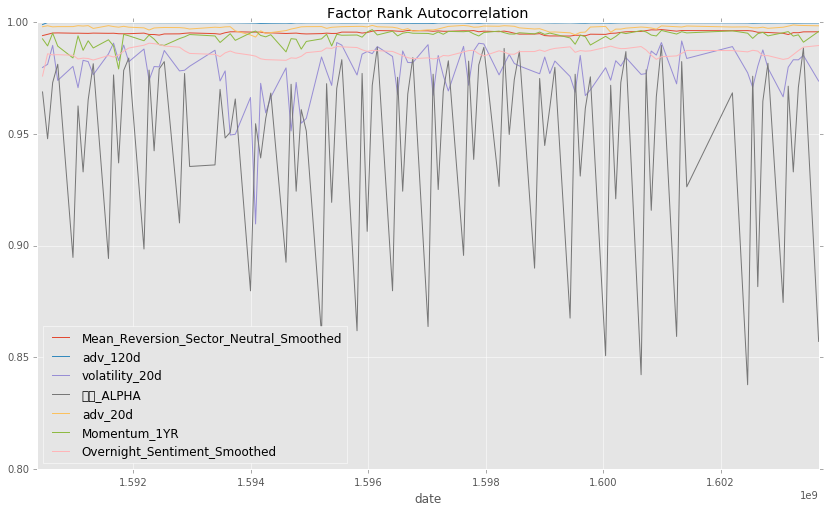

In [36]:
show_sample_results(all_factors, X_test, clf, factor_names)

标签是五日回报，相邻的两个标签有4日是重叠的，导致标签之间自相关性较强。
此处消除标签的自相关性，降低过拟合的可能性。

## 样本重叠
通过yi
Let's fix this by removing overlapping samples. We can do a number of things:

- Don't use overlapping samples
- Use BaggingClassifier's `max_samples`
- Build an ensemble of non-overlapping trees

In this project, we'll do all three methods and compare.
### Drop Overlapping Samples
This is the simplest of the three methods. We'll just drop any overlapping samples from the dataset. Implement the `non_overlapping_samples` function to return a new dataset overlapping samples. 

In [ ]:
def non_overlapping_samples(x, y, n_skip_samples, start_i=0):
    """
    Get the non overlapping samples.

    Parameters
    ----------
    x : DataFrame
        The input samples
    y : Pandas Series
        The target values
    n_skip_samples : int
        The number of samples to skip
    start_i : int
        The starting index to use for the data
    
    Returns
    -------
    non_overlapping_x : 2 dimensional Ndarray
        The non overlapping input samples
    non_overlapping_y : 1 dimensional Ndarray
        The non overlapping target values
    """
    assert len(x.shape) == 2
    assert len(y.shape) == 1
    
    start_i = start_i % (n_skip_samples + 1)
    
    # TODO: Implement
    subsampled_idx = x.index.levels[0].tolist()[start_i :: n_skip_samples + 1]
    non_overlapping_x = x.loc[subsampled_idx]
    non_overlapping_y = y.loc[subsampled_idx]
    
    return non_overlapping_x, non_overlapping_y


project_tests.test_non_overlapping_samples(non_overlapping_samples)

This seems much "better" in the sense that we have much better fidelity between the three.


### Build an ensemble of non-overlapping trees
The last method is to create ensemble of non-overlapping trees. Here we are going to write a custom `scikit-learn` estimator. We inherit from `VotingClassifier` and we override the `fit` method so we fit on non-overlapping periods.

In [56]:
import abc

from sklearn.ensemble import VotingClassifier
from sklearn.base import clone
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import Bunch


class NoOverlapVoterAbstract(VotingClassifier):
    @abc.abstractmethod
    def _calculate_oob_score(self, classifiers):
        raise NotImplementedError
        
    @abc.abstractmethod
    def _non_overlapping_estimators(self, x, y, classifiers, n_skip_samples):
        raise NotImplementedError
    
    def __init__(self, estimator, voting='soft', n_skip_samples=4):
        # List of estimators for all the subsets of data
        estimators = [('clf'+str(i), estimator) for i in range(n_skip_samples + 1)]
        
        self.n_skip_samples = n_skip_samples
        super().__init__(estimators, voting)
    
    def fit(self, X, y, sample_weight=None):
        estimator_names, clfs = zip(*self.estimators)
        self.le_ = LabelEncoder().fit(y)
        self.classes_ = self.le_.classes_
        
        clone_clfs = [clone(clf) for clf in clfs]
        self.estimators_ = self._non_overlapping_estimators(X, y, clone_clfs, self.n_skip_samples)
        self.named_estimators_ = Bunch(**dict(zip(estimator_names, self.estimators_)))
        self.oob_score_ = self._calculate_oob_score(self.estimators_)
        
        return self

You might notice that two of the functions are abstracted. These will be the functions that you need to implement.
#### OOB Score
In order to get the correct OOB score, we need to take the average of all the estimator's OOB scores. Implement `calculate_oob_score` to calculate this score.

In [57]:
def calculate_oob_score(classifiers):
    """
    Calculate the mean out-of-bag score from the classifiers.

    Parameters
    ----------
    classifiers : list of Scikit-Learn Classifiers
        The classifiers used to calculate the mean out-of-bag score
    
    Returns
    -------
    oob_score : float
        The mean out-of-bag score
    """
    
    # TODO: Implement
    oob_score = 0
    for clf in classifiers:
        oob_score = oob_score + clf.oob_score_
    
    return oob_score / len(classifiers)


project_tests.test_calculate_oob_score(calculate_oob_score)

Tests Passed


#### Non Overlapping Estimators
With `calculate_oob_score` implemented, let's create non overlapping estimators. Implement `non_overlapping_estimators` to build non overlapping subsets of the data, then run a estimator on each subset of data.

In [58]:
def non_overlapping_estimators(x, y, classifiers, n_skip_samples):
    """
    Fit the classifiers to non overlapping data.

    Parameters
    ----------
    x : DataFrame
        The input samples
    y : Pandas Series
        The target values
    classifiers : list of Scikit-Learn Classifiers
        The classifiers used to fit on the non overlapping data
    n_skip_samples : int
        The number of samples to skip
    
    Returns
    -------
    fit_classifiers : list of Scikit-Learn Classifiers
        The classifiers fit to the the non overlapping data
    """
    
    # TODO: Implement
    fit_classifiers = []
    for start_idx, clf in enumerate(classifiers):
        X_resampled, y_resampled = non_overlapping_samples(x, y, n_skip_samples, start_idx)
        fit_classifiers.append(clf.fit(X_resampled, y_resampled))
        

    return fit_classifiers


# project_tests.test_non_overlapping_estimators(non_overlapping_estimators)

In [59]:
class NoOverlapVoter(NoOverlapVoterAbstract):
    def _calculate_oob_score(self, classifiers):
        return calculate_oob_score(classifiers)
        
    def _non_overlapping_estimators(self, x, y, classifiers, n_skip_samples):
        return non_overlapping_estimators(x, y, classifiers, n_skip_samples)

Now that we have our `NoOverlapVoter` class, let's train it.

#### Train Model

In [60]:
train_score = []
valid_score = []
oob_score = []

for n_trees in tqdm(n_trees_l, desc='Training Models', unit='Model'):
    clf = RandomForestClassifier(n_trees, **clf_parameters)
    
    clf_nov = NoOverlapVoter(clf)
    clf_nov.fit(X_train, y_train)
    
    train_score.append(clf_nov.score(X_train, y_train.values))
    valid_score.append(clf_nov.score(X_valid, y_valid.values))
    oob_score.append(clf_nov.oob_score_)

Training Models:   0%|          | 0/5 [00:00<?, ?Model/s]/Users/tianjili/opt/anaconda3/envs/env_zipline/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/Users/tianjili/opt/anaconda3/envs/env_zipline/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
Training Models:  20%|██        | 1/5 [00:06<00:26,  6.70s/Model]/Users/tianjili/opt/anaconda3/envs/env_zipline/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0`

#### Results

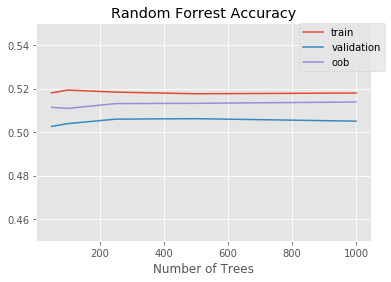

In [63]:
project_helper.plot(
    [n_trees_l]*3,
    [train_score, valid_score, oob_score],
    ['train', 'validation', 'oob'],
    'Random Forrest Accuracy',
    'Number of Trees')

[0.49368656 0.50631344]
Cleaning Data...

Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss i

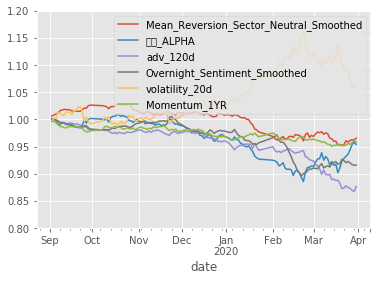

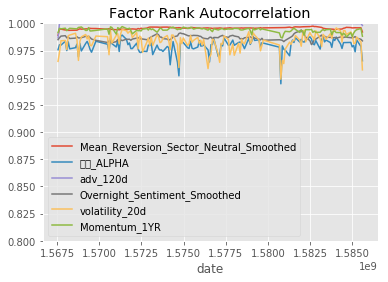

In [62]:
show_sample_results(all_factors, X_valid, clf_nov, factor_names)

## Final Model
### Re-Training Model
In production, we would roll forward the training. Typically you would re-train up to the "current day" and then test. Here, we will train on the train & validation dataset.

In [64]:
n_trees = 500

clf = RandomForestClassifier(n_trees, **clf_parameters)
clf_nov = NoOverlapVoter(clf)
clf_nov.fit(
    pd.concat([X_train, X_valid]),
    pd.concat([y_train, y_valid]))

NoOverlapVoter(estimator=None, n_skip_samples=4, voting='soft')

### Results
#### Accuracy

In [65]:
print('train: {}, oob: {}, valid: {}'.format(
    clf_nov.score(X_train, y_train.values),
    clf_nov.score(X_valid, y_valid.values),
    clf_nov.oob_score_))

/Users/tianjili/opt/anaconda3/envs/env_zipline/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


train: 0.517796296199665, oob: 0.518800876643707, valid: 0.5129989518924546


/Users/tianjili/opt/anaconda3/envs/env_zipline/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


#### Train

[0.49731067 0.50268933]
Cleaning Data...

Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.2% entries from factor data: 0.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss i

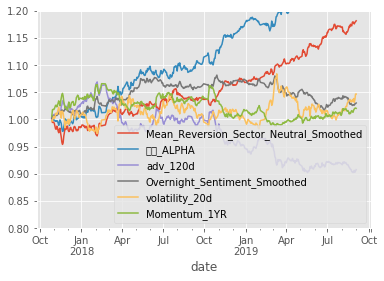

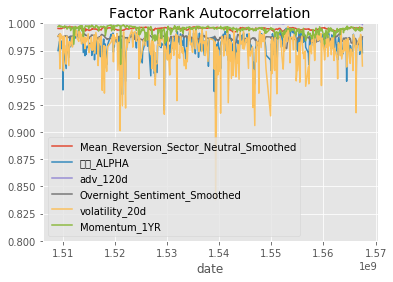

In [66]:
show_sample_results(all_factors, X_train, clf_nov, factor_names)

#### Validation

[0.49589671 0.50410329]
Cleaning Data...

Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss i

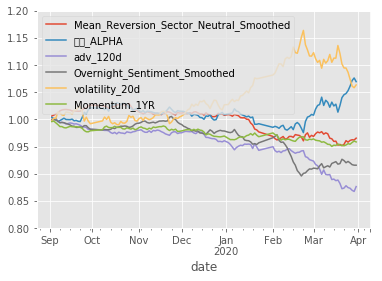

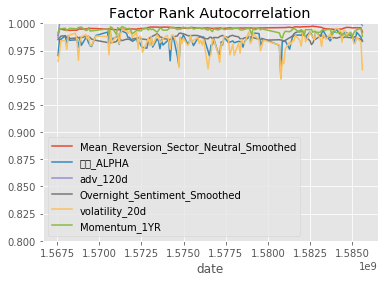

In [67]:
show_sample_results(all_factors, X_valid, clf_nov, factor_names)

#### Test

[0.49047583 0.50952417]
Cleaning Data...

Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Dropped 0.0% entries from factor data: 0.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss i

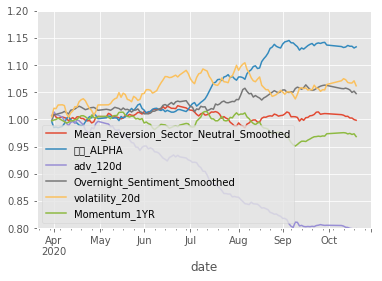

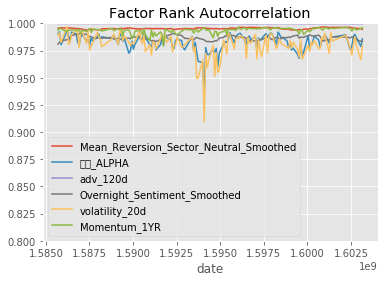

In [68]:
show_sample_results(all_factors, X_test, clf_nov, factor_names)

So, hopefully you are appropriately amazed by this. Despite the significant differences between the factor performances in the three sets, the AI APLHA is able to deliver positive performance.